# **Library**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import pathlib
from sklearn import svm
from PIL import Image, ImageEnhance
from tqdm import tqdm
from collections import Counter
from scipy.stats import skew
from skimage import io, exposure
from skimage.feature import graycomatrix, graycoprops, hog, local_binary_pattern
from skimage.color import rgb2gray
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, Input
from tensorflow.keras.layers import Rescaling
from tensorflow.keras.layers import RandomFlip, RandomRotation, RandomZoom, RandomContrast, BatchNormalization, RandomBrightness
from tensorflow.keras.applications import ResNet101
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Model
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

# **Load Dataset**

In [ ]:
h, w = 300, 300
batch = 32
num_classes = 6
data_dir = '/content/drive/MyDrive/Dataset/Jenis Kain/Jenis Kain/'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']
features = []
labels = []

# **EDA**

In [ ]:
# Counting images per class
def count_images_per_class(data_dir, classes):
    class_counts = {}
    for class_name in classes:
        class_path = os.path.join(data_dir, class_name)
        class_counts[class_name] = len(os.listdir(class_path))
    return class_counts

class_counts = count_images_per_class(data_dir, classes)

## **Distribusi Citra setiap Kelas**

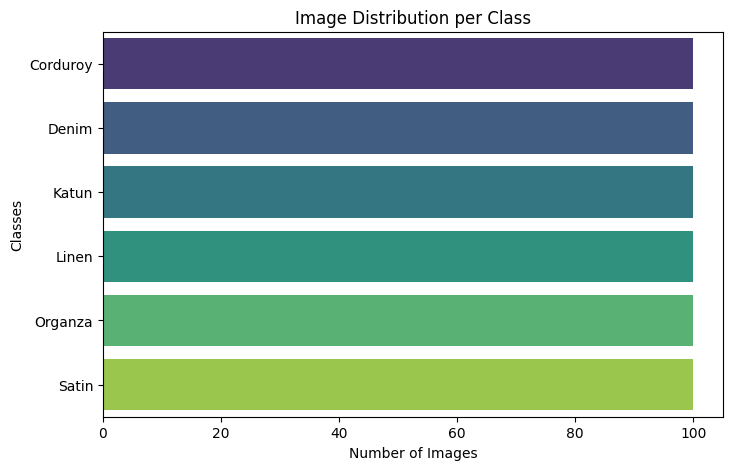

In [ ]:
# Visualizing class distribution
plt.figure(figsize=(8, 5))
sns.barplot(x=list(class_counts.values()), y=list(class_counts.keys()), hue=list(class_counts.keys()),palette='viridis', legend=False)
plt.title('Image Distribution per Class')
plt.xlabel('Number of Images')
plt.ylabel('Classes')
plt.show()

## **Citra setiap Kelas**

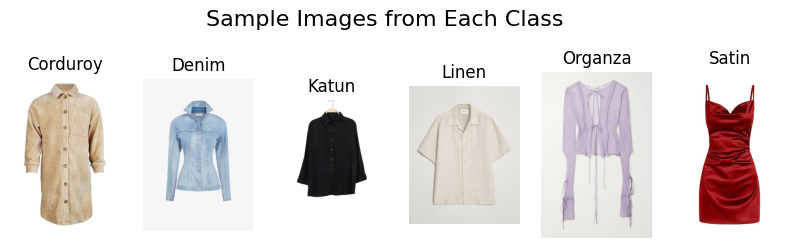

In [ ]:
# Displaying example images from each class
fig, axes = plt.subplots(1, num_classes, figsize=(10, 3))
fig.suptitle('Sample Images from Each Class', fontsize=16)

for i, class_name in enumerate(classes):
    class_path = os.path.join(data_dir, class_name)
    if os.path.isdir(class_path) and len(os.listdir(class_path)) > 0:
        img_path = os.path.join(class_path, os.listdir(class_path)[0])
        img = Image.open(img_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(class_name)

plt.show()

## **Dimensi Citra setiap Kelas**

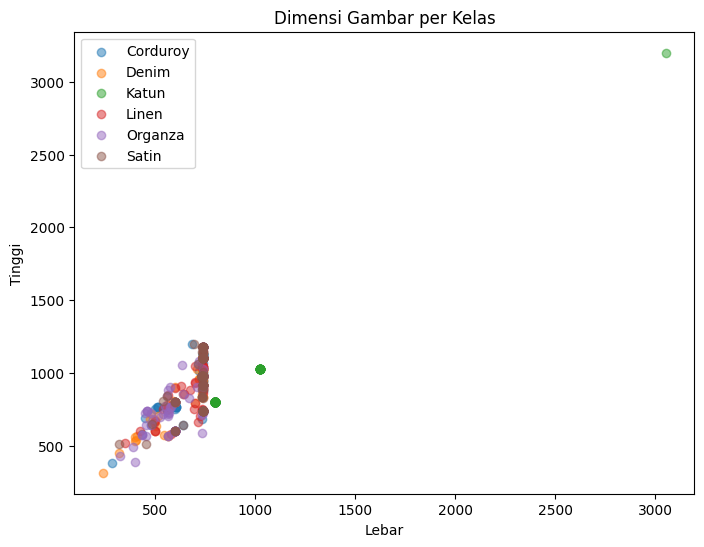

In [ ]:
def analyze_image_sizes(data_dir, classes):
    return {class_name: [Image.open(os.path.join(data_dir, class_name, img_name)).size for img_name in os.listdir(os.path.join(data_dir, class_name))] for class_name in classes}

def plot_image_dimensions(dimensions, classes):
    plt.figure(figsize=(8, 6))
    for class_name in classes:
        widths, heights = zip(*dimensions[class_name])
        plt.scatter(widths, heights, label=class_name, alpha=0.5)
    plt.title('Dimensi Gambar per Kelas')
    plt.xlabel('Lebar')
    plt.ylabel('Tinggi')
    plt.legend()
    plt.show()

dimensions = analyze_image_sizes(data_dir, classes)
plot_image_dimensions(dimensions, classes)

## **Visualisasi Kemiripan Antar Kelas**

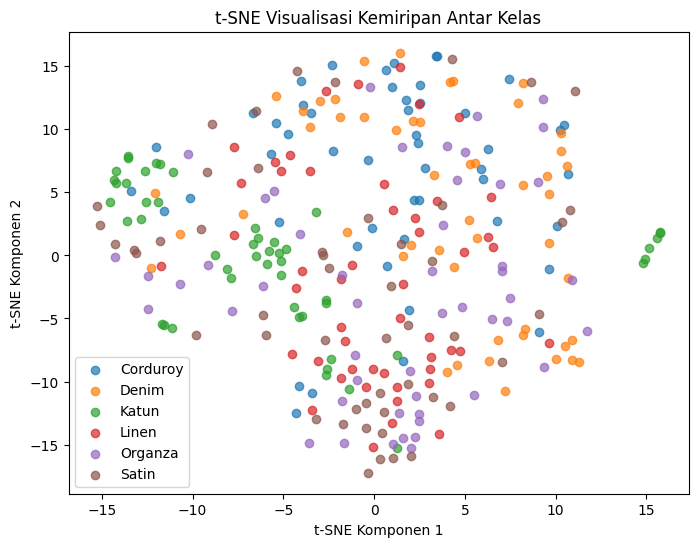

In [ ]:
def visualize_tsne(data_dir, classes, n_samples=50):
    features = []
    labels = []

    for i, class_name in enumerate(classes):
        img_paths = [os.path.join(data_dir, class_name, img_name) for img_name in os.listdir(os.path.join(data_dir, class_name))[:n_samples]]
        features.extend(np.array(Image.open(img_path).convert('L').resize((32, 32))).flatten() for img_path in img_paths)
        labels.extend([i] * n_samples)

    features_tsne = TSNE(n_components=2, random_state=42).fit_transform(np.array(features))

    plt.figure(figsize=(8, 6))
    for i, class_name in enumerate(classes):
        mask = np.array(labels) == i
        plt.scatter(features_tsne[mask, 0], features_tsne[mask, 1], label=class_name, alpha=0.7)
    plt.title('t-SNE Visualisasi Kemiripan Antar Kelas')
    plt.xlabel('t-SNE Komponen 1')
    plt.ylabel('t-SNE Komponen 2')
    plt.legend()
    plt.show()

visualize_tsne(data_dir, classes)

# **Resize Nearest dan Sharpen**

Memproses gambar dengan metode NEAREST dan penajaman...


Memproses Satin: 100%|██████████| 100/100 [00:38<00:00,  2.62it/s]



Menampilkan hasil proses (NEAREST + Sharpening) untuk setiap kelas...


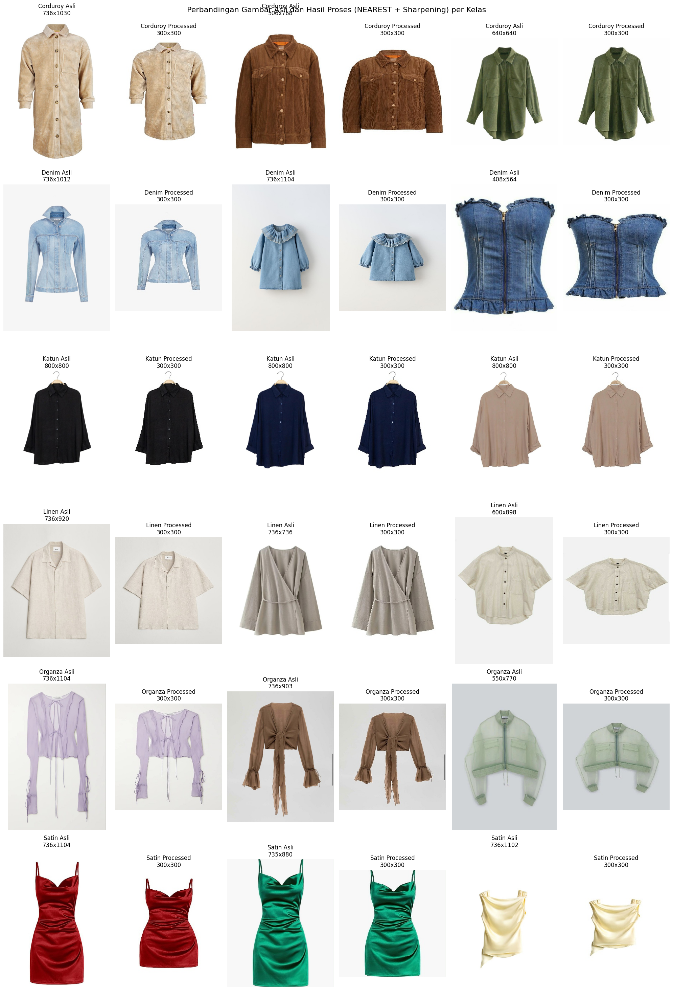

Proses selesai. Gambar yang telah diproses tersimpan dalam folder '[nama_kelas]_processed'.


In [ ]:
def resize_and_sharpen(img, target_size, sharpen_factor=1.5):
    img_resized = img.resize(target_size, Image.NEAREST)
    enhancer = ImageEnhance.Sharpness(img_resized)
    img_sharpened = enhancer.enhance(sharpen_factor)
    return img_sharpened

def process_images(data_dir, classes, target_size=(300, 300), sharpen_factor=1.5):
    processed_paths = {cls: [] for cls in classes}
    for class_name in classes:
        class_path = os.path.join(data_dir, class_name)
        if not os.path.isdir(class_path):
            print(f"Direktori tidak ditemukan: {class_path}")
            continue

        processed_class_path = os.path.join(data_dir, f"{class_name}_processed")
        os.makedirs(processed_class_path, exist_ok=True)

        for img_name in tqdm(os.listdir(class_path), desc=f"Memproses {class_name}"):
            img_path = os.path.join(class_path, img_name)

            try:
                with Image.open(img_path) as img:
                    img_processed = resize_and_sharpen(img, target_size, sharpen_factor)
                    new_img_path = os.path.join(processed_class_path, img_name)
                    img_processed.save(new_img_path, quality=95)
                    processed_paths[class_name].append(new_img_path)
            except Exception as e:
                print(f"Error saat memproses {img_path}: {str(e)}")

    return processed_paths

def display_sample_images_per_class(original_paths, processed_paths, num_samples=3):
    num_classes = len(original_paths)
    fig, axes = plt.subplots(num_classes, num_samples * 2, figsize=(20, 5 * num_classes))
    fig.suptitle("Perbandingan Gambar Asli dan Hasil Proses (NEAREST + Sharpening) per Kelas", fontsize=16)

    for idx, (class_name, orig_paths) in enumerate(original_paths.items()):
        proc_paths = processed_paths[class_name]

        for i in range(num_samples):
            if i < len(orig_paths):
                # Gambar asli
                orig_img = Image.open(orig_paths[i])
                axes[idx, i*2].imshow(orig_img)
                axes[idx, i*2].set_title(f"{class_name} Asli\n{orig_img.size[0]}x{orig_img.size[1]}")
                axes[idx, i*2].axis('off')

                # Gambar hasil proses
                proc_img = Image.open(proc_paths[i])
                axes[idx, i*2+1].imshow(proc_img)
                axes[idx, i*2+1].set_title(f"{class_name} Processed\n{proc_img.size[0]}x{proc_img.size[1]}")
                axes[idx, i*2+1].axis('off')

    plt.tight_layout()
    plt.show()

# Pengaturan awal
target_size = (300, 300)
sharpen_factor = 1.5
num_samples_per_class = 3

# Fungsi untuk mendapatkan path gambar asli
def get_original_paths(data_dir, classes, num_samples=3):
    original_paths = {cls: [] for cls in classes}
    for class_name in classes:
        class_path = os.path.join(data_dir, class_name)
        if os.path.isdir(class_path):
            img_paths = [os.path.join(class_path, img_name) for img_name in os.listdir(class_path)]
            original_paths[class_name] = img_paths[:num_samples]
    return original_paths

# Proses gambar dengan metode NEAREST dan penajaman
print("Memproses gambar dengan metode NEAREST dan penajaman...")
processed_paths = process_images(data_dir, classes, target_size, sharpen_factor)

# Tampilkan hasil
original_paths = get_original_paths(data_dir, classes, num_samples_per_class)
print("\nMenampilkan hasil proses (NEAREST + Sharpening) untuk setiap kelas...")
display_sample_images_per_class(original_paths, processed_paths, num_samples_per_class)

print("Proses selesai. Gambar yang telah diproses tersimpan dalam folder '[nama_kelas]_processed'.")

# **GreyScale**

Converting Satin_resized to Grayscale: 100%|██████████| 5/5 [00:01<00:00,  3.54it/s]



Menampilkan hasil konversi grayscale untuk setiap kelas...


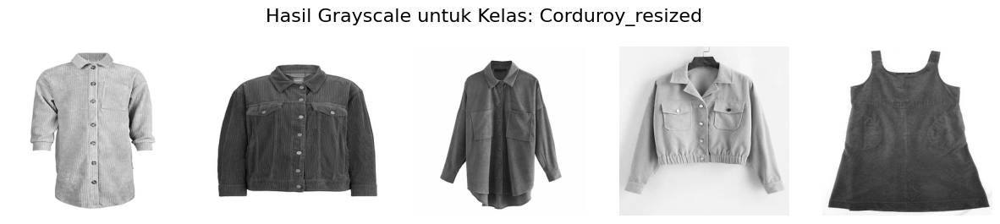

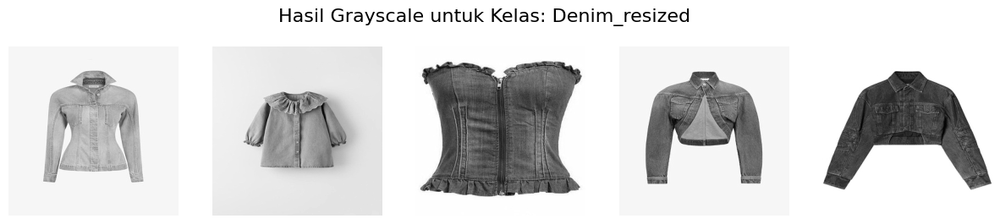

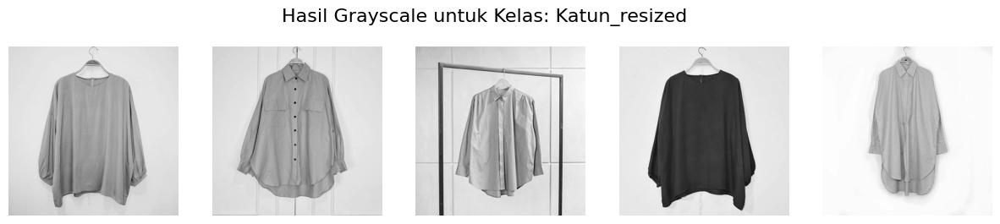

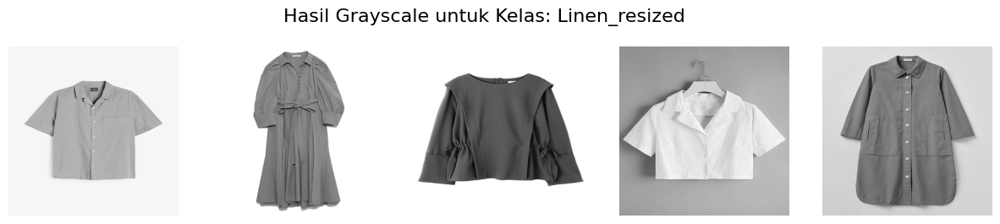

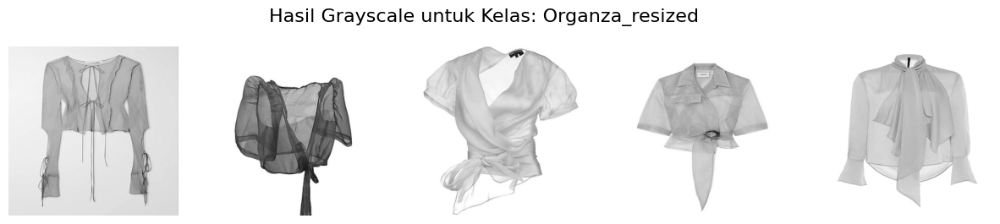

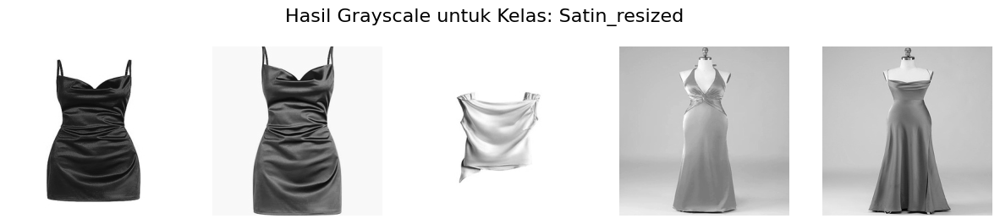

In [ ]:
def convert_to_grayscale(data_dir, classes, num_samples_per_class=5):
    """Fungsi untuk mengonversi gambar ke grayscale dan menyimpannya dalam dictionary per kelas."""
    grayscale_images = {}

    for class_name in classes:
        class_path = os.path.join(data_dir, class_name)
        if not os.path.isdir(class_path):
            print(f"Direktori tidak ditemukan: {class_path}")
            continue

        # Inisialisasi list untuk gambar grayscale per kelas
        grayscale_images[class_name] = []

        # Iterasi melalui semua gambar dalam kelas
        for img_name in tqdm(os.listdir(class_path)[:num_samples_per_class], desc=f"Converting {class_name} to Grayscale"):
            img_path = os.path.join(class_path, img_name)

            try:
                with Image.open(img_path) as img:
                    # Konversi gambar ke grayscale
                    img_gray = img.convert('L')
                    grayscale_images[class_name].append(img_gray)
            except Exception as e:
                print(f"Error saat memproses {img_path}: {str(e)}")

    return grayscale_images

def display_sample_images_per_class(grayscale_images):
    """Fungsi untuk menampilkan beberapa sampel gambar grayscale per kelas dalam bentuk grid."""
    for class_name, images in grayscale_images.items():
        num_images = len(images)

        # Tentukan ukuran grid berdasarkan jumlah gambar
        cols = min(num_images, 5)
        rows = (num_images // cols) + (num_images % cols > 0)

        plt.figure(figsize=(15, 3 * rows))
        plt.suptitle(f"Hasil Grayscale untuk Kelas: {class_name}", fontsize=16)

        for i, img_gray in enumerate(images):
            plt.subplot(rows, cols, i + 1)
            plt.imshow(img_gray, cmap='gray')
            plt.axis('off')

        plt.show()

# Panggil fungsi untuk melakukan konversi ke grayscale dan menampilkan hasilnya
data_dir = '/content/drive/MyDrive/Dataset/Jenis Kain/Jenis Kain/'
classes = ['Corduroy_resized', 'Denim_resized', 'Katun_resized', 'Linen_resized', 'Organza_resized', 'Satin_resized']
num_samples_per_class = 5

# Konversi ke grayscale dan simpan dalam dictionary
grayscale_images = convert_to_grayscale(data_dir, classes, num_samples_per_class)

# Tampilkan hasil konversi grayscale per kelas
print("\nMenampilkan hasil konversi grayscale untuk setiap kelas...")
display_sample_images_per_class(grayscale_images)


# **Feature Extraction**

## **Histogram Warna**

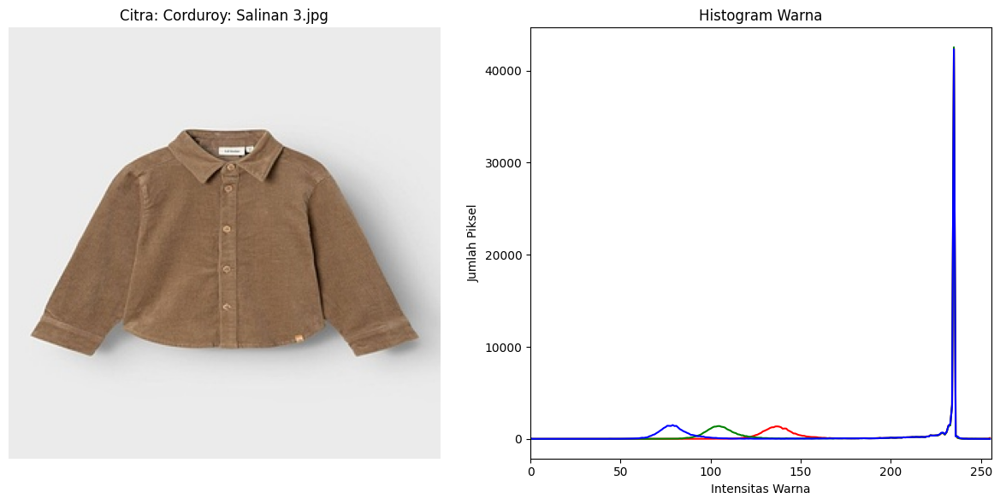

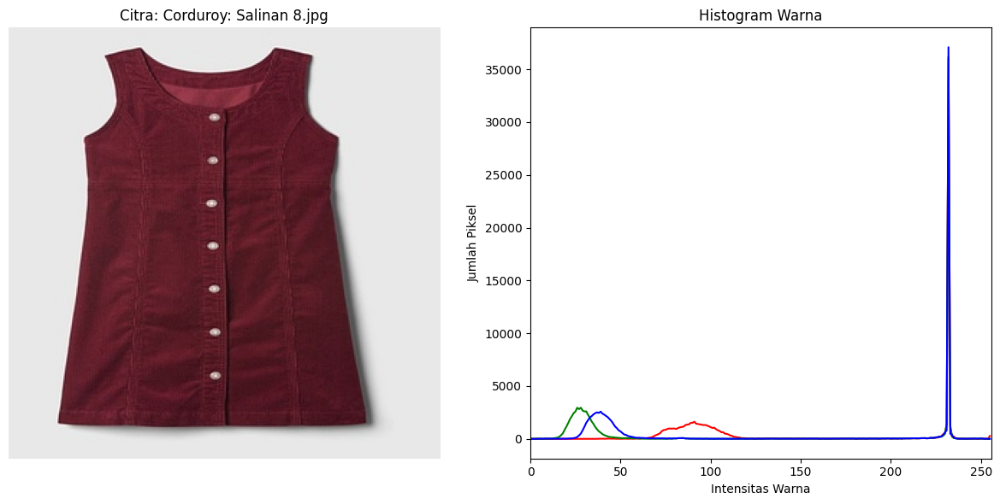

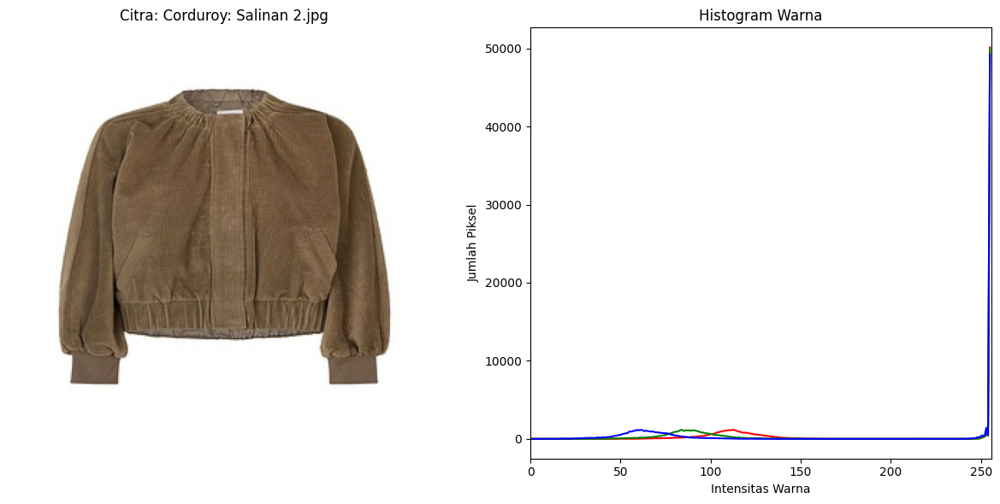

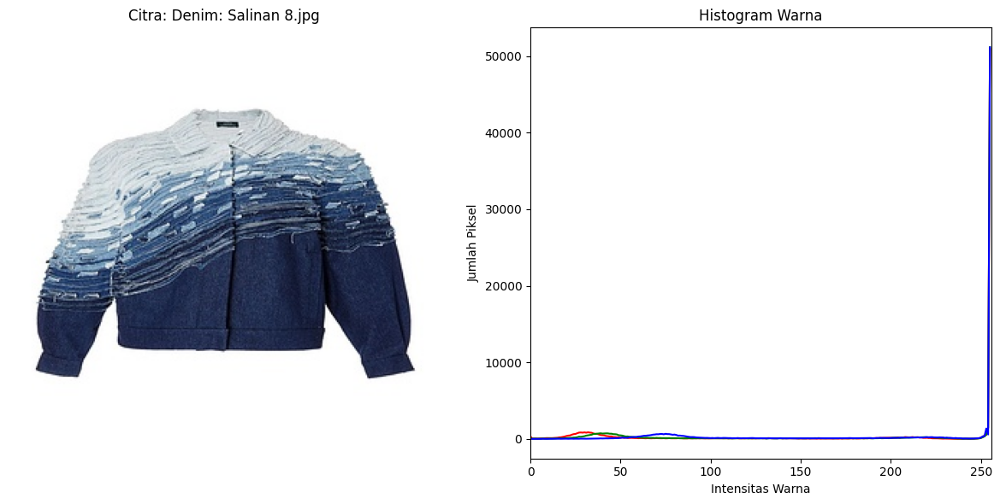

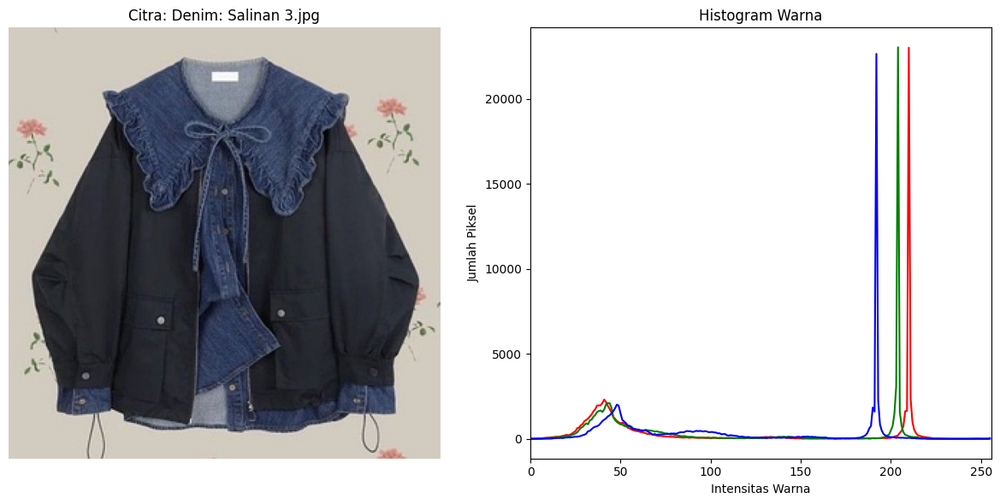

...

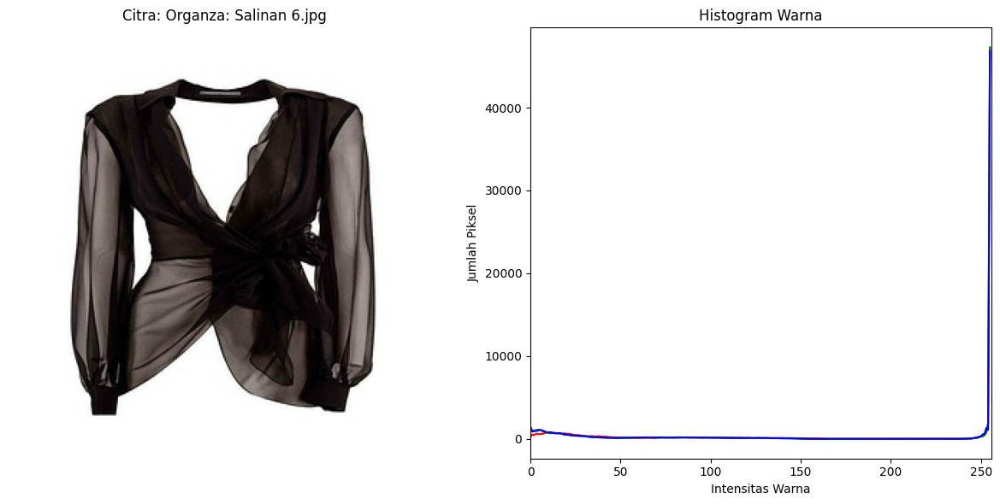

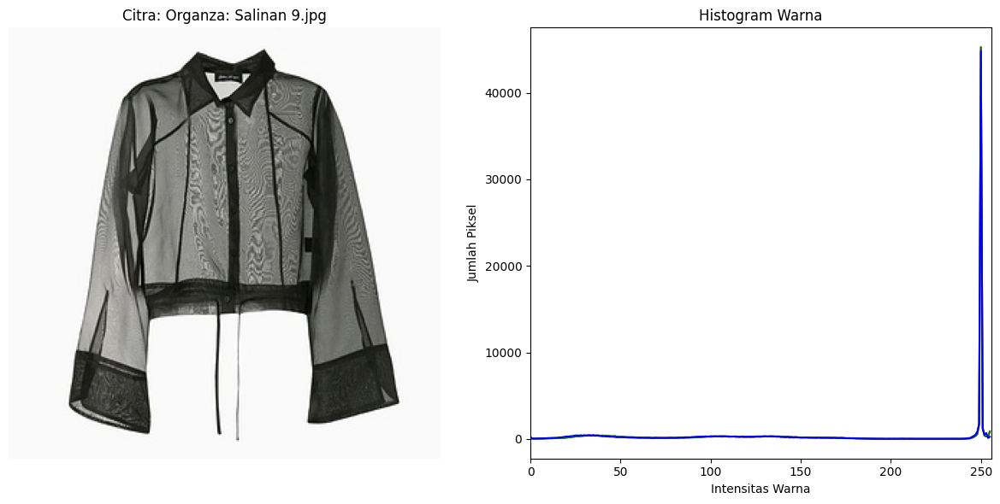

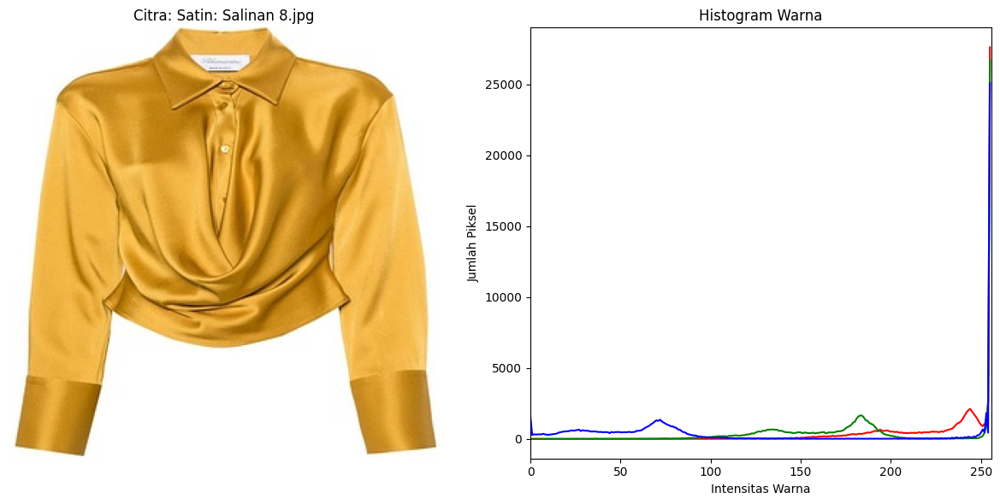

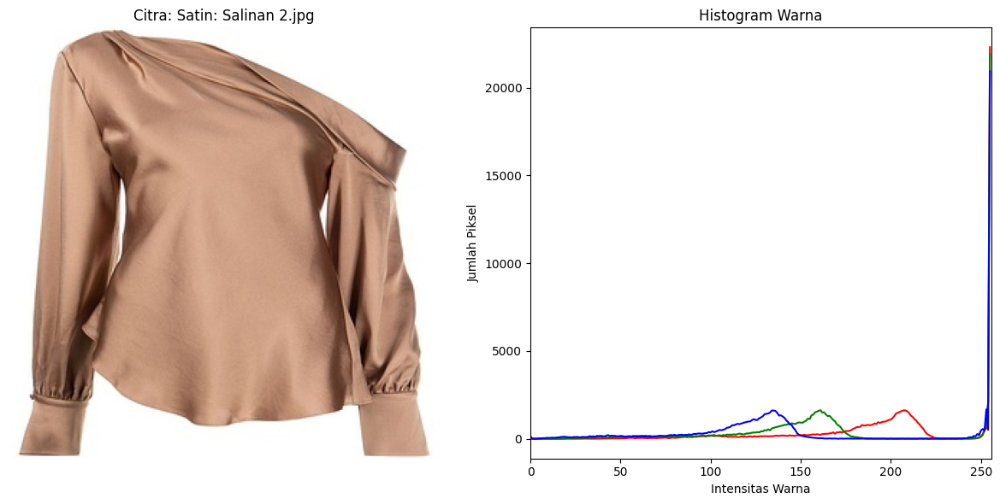

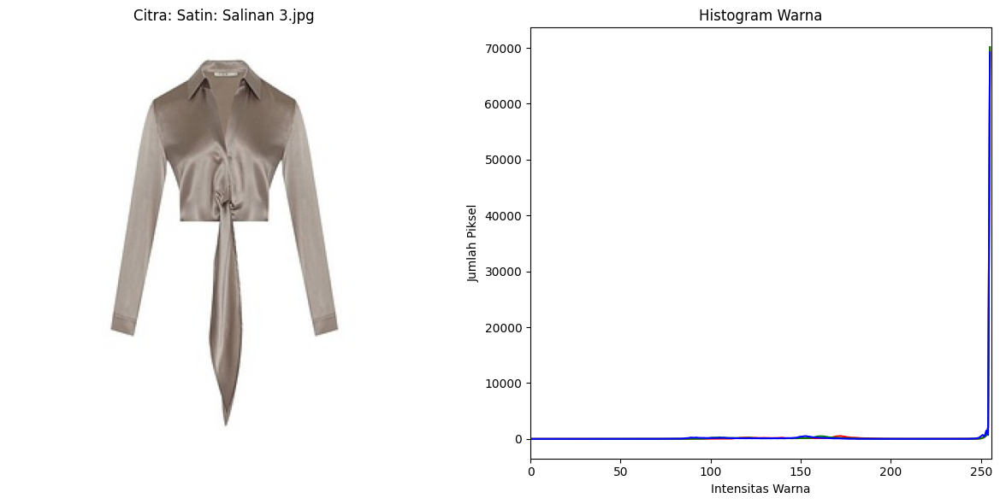

In [ ]:
data_dir = '/content/drive/MyDrive/Dataset/Jenis Kain/Hasil Resize/'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

def plot_image_and_histogram(image, title):
    colors = ('r', 'g', 'b')
    plt.figure(figsize=(12, 6))

    # Menampilkan citra
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title(f"Citra: {title}")
    plt.axis('off')

    # Menampilkan histogram
    plt.subplot(1, 2, 2)
    for i, color in enumerate(colors):
        histogram = cv2.calcHist([image], [i], None, [256], [0, 256])
        plt.plot(histogram, color=color)
        plt.xlim([0, 256])

    plt.title('Histogram Warna')
    plt.xlabel('Intensitas Warna')
    plt.ylabel('Jumlah Piksel')
    plt.tight_layout()
    plt.show()

# Menampilkan beberapa citra beserta histogramnya
num_images_to_display = 3

for class_name in classes:
    class_dir = os.path.join(data_dir, class_name)

    image_files = os.listdir(class_dir)[:num_images_to_display]

    for img_name in image_files:
        img_path = os.path.join(class_dir, img_name)
        image = cv2.imread(img_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        plot_image_and_histogram(image_rgb, f"{class_name}: {img_name}")

## **Moment Warna**

Moment warna untuk Corduroy: Salinan 3.jpg:
Mean (R, G, B): 200.86, 190.99, 182.92
Variance (R, G, B): 2066.60, 3520.26, 5012.49
Skewness (R, G, B): -0.79, -0.77, -0.77


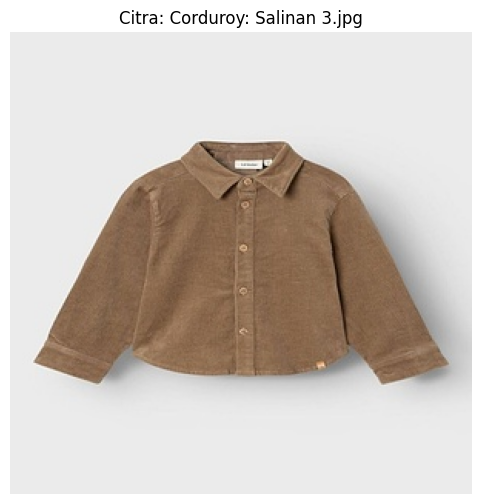

Moment warna untuk Corduroy: Salinan 8.jpg:
Mean (R, G, B): 158.85, 127.96, 133.36
Variance (R, G, B): 4959.09, 9990.96, 8959.47
Skewness (R, G, B): 0.01, 0.04, 0.04


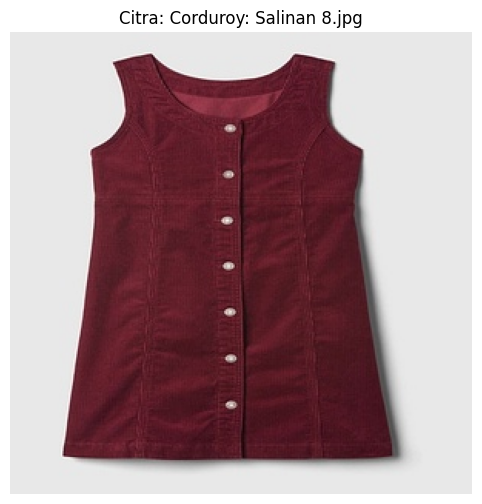

Moment warna untuk Denim: Salinan 8.jpg:
Mean (R, G, B): 186.38, 191.55, 201.11
Variance (R, G, B): 9036.86, 8052.08, 5908.40
Skewness (R, G, B): -0.86, -0.92, -0.97


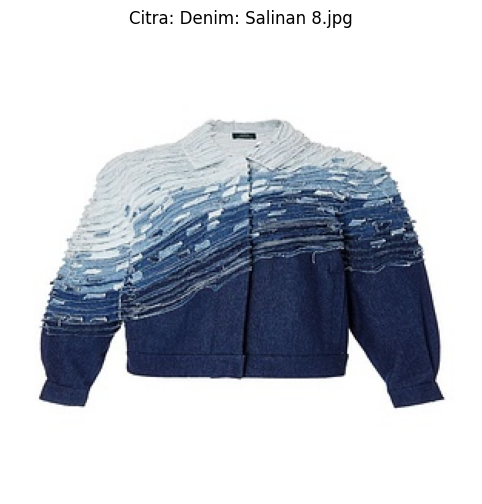

Moment warna untuk Denim: Salinan 3.jpg:
Mean (R, G, B): 111.60, 111.76, 115.14
Variance (R, G, B): 6565.88, 5799.85, 4329.70
Skewness (R, G, B): 0.31, 0.28, 0.15


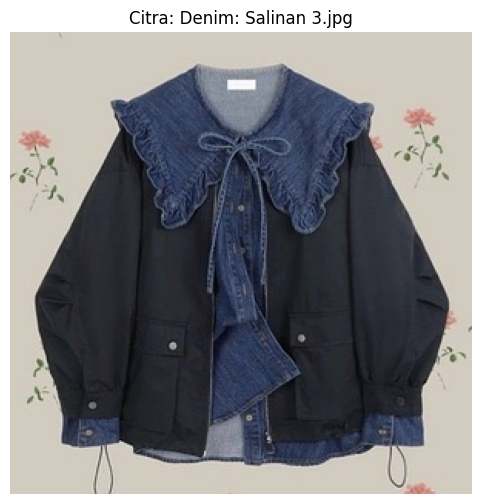

Moment warna untuk Katun: Salinan 4.jpg:
Mean (R, G, B): 207.00, 203.90, 219.21
Variance (R, G, B): 801.67, 1128.64, 339.31
Skewness (R, G, B): -1.18, -1.03, -1.95


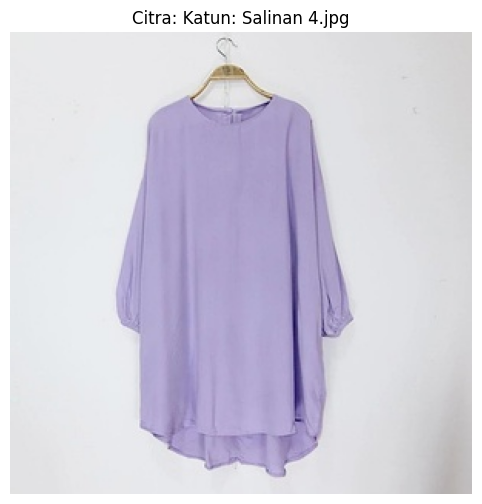

Moment warna untuk Katun: Salinan 5.jpg:
Mean (R, G, B): 189.05, 173.85, 167.23
Variance (R, G, B): 2062.84, 4616.81, 6623.39
Skewness (R, G, B): -0.92, -0.81, -0.78


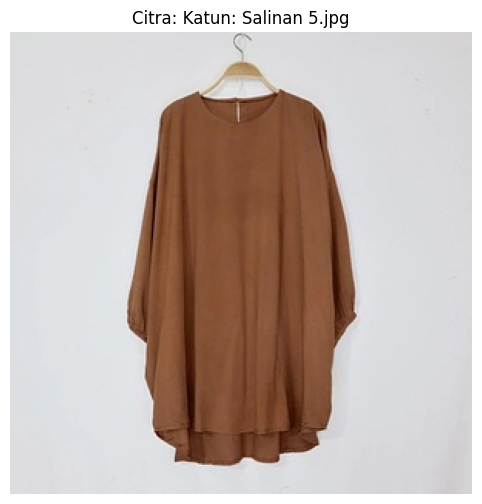

Moment warna untuk Linen: Salinan 4.jpg:
Mean (R, G, B): 230.44, 228.88, 227.63
Variance (R, G, B): 253.26, 389.22, 553.31
Skewness (R, G, B): -2.60, -2.65, -2.23


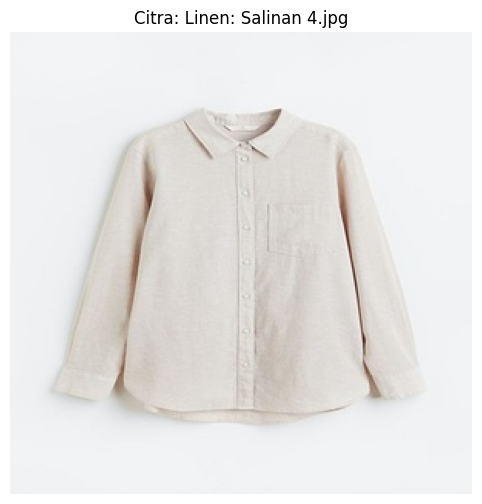

Moment warna untuk Linen: Salinan 2.jpg:
Mean (R, G, B): 197.26, 189.23, 182.86
Variance (R, G, B): 753.47, 1001.94, 1549.26
Skewness (R, G, B): -0.76, -0.59, -0.43


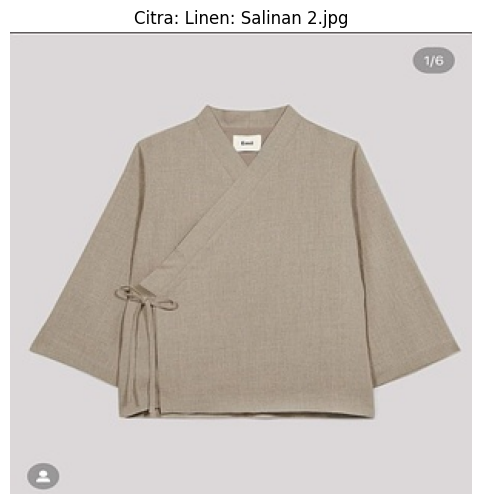

Moment warna untuk Organza: Salinan 3.jpg:
Mean (R, G, B): 235.84, 232.77, 229.37
Variance (R, G, B): 2128.05, 2310.48, 2484.30
Skewness (R, G, B): -3.51, -3.10, -2.59


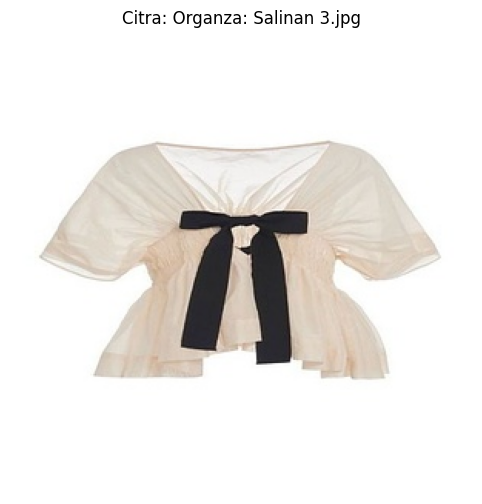

Moment warna untuk Organza: Salinan 6.jpg:
Mean (R, G, B): 168.69, 165.42, 164.78
Variance (R, G, B): 10937.44, 11642.36, 11734.90
Skewness (R, G, B): -0.51, -0.48, -0.47


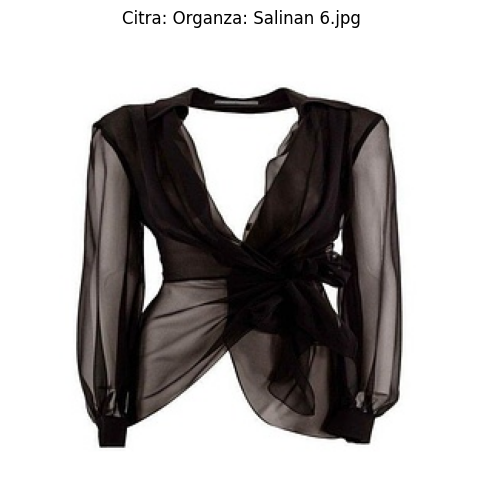

Moment warna untuk Satin: Salinan 8.jpg:
Mean (R, G, B): 230.61, 193.06, 124.38
Variance (R, G, B): 888.71, 2640.57, 9600.61
Skewness (R, G, B): -1.37, -0.10, 0.44


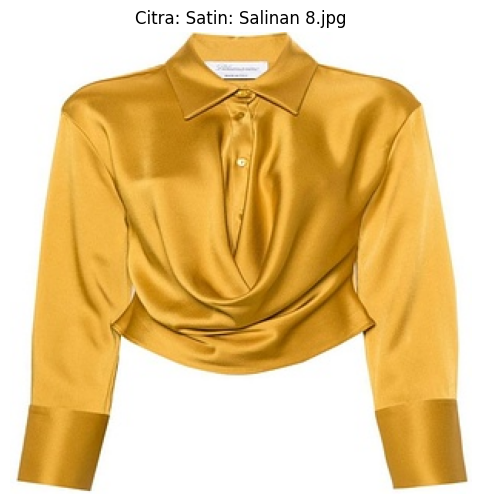

Moment warna untuk Satin: Salinan 2.jpg:
Mean (R, G, B): 200.94, 170.54, 153.64
Variance (R, G, B): 2285.02, 3858.45, 4943.19
Skewness (R, G, B): -0.91, -0.02, 0.32


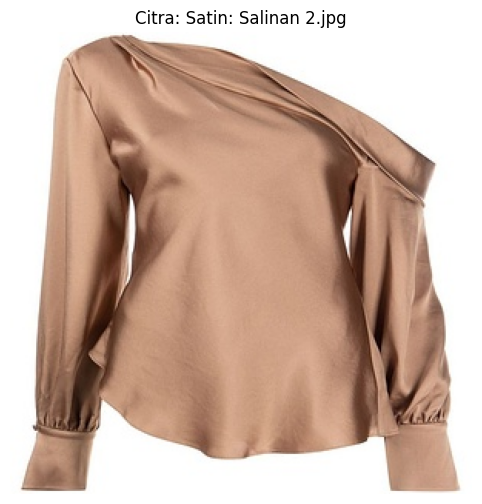

In [ ]:
data_dir = '/content/drive/MyDrive/Dataset/Jenis Kain/Kain Model'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

def calculate_color_moments(image):
    channels = cv2.split(image)
    color_moments = []

    # Menghitung mean, variance, dan skewness untuk setiap saluran warna
    for channel in channels:
        mean = np.mean(channel)
        variance = np.var(channel)
        skewness = skew(channel.flatten())

        color_moments.extend([mean, variance, skewness])

    return color_moments

# Fungsi untuk menampilkan citra dan fitur moment warnanya
def plot_image_and_color_moments(image, title, moments):
    plt.figure(figsize=(8, 6))

    # Menampilkan citra
    plt.imshow(image)
    plt.title(f"Citra: {title}")
    plt.axis('off')

    # Menampilkan moment warna
    print(f"Moment warna untuk {title}:")
    print(f"Mean (R, G, B): {moments[0]:.2f}, {moments[3]:.2f}, {moments[6]:.2f}")
    print(f"Variance (R, G, B): {moments[1]:.2f}, {moments[4]:.2f}, {moments[7]:.2f}")
    print(f"Skewness (R, G, B): {moments[2]:.2f}, {moments[5]:.2f}, {moments[8]:.2f}")

    plt.show()

# Menampilkan beberapa citra beserta moment warnanya
num_images_to_display = 2

for class_name in classes:
    class_dir = os.path.join(data_dir, class_name)

    image_files = os.listdir(class_dir)[:num_images_to_display]

    for img_name in image_files:
        img_path = os.path.join(class_dir, img_name)

        image = cv2.imread(img_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        color_moments = calculate_color_moments(image_rgb)

        plot_image_and_color_moments(image_rgb, f"{class_name}: {img_name}", color_moments)

## **HOG (Tekstur)**


Fitur GLCM untuk Corduroy: Salinan 3.jpg:
Kontras: 59.07, Dissimilarity: 2.50, Homogeneity: 0.67, Energy: 0.47, Correlation: 0.99
Hu Moments untuk Corduroy: Salinan 3.jpg:
[9.74967697e-04 9.50783184e-10 8.45195865e-13 5.49481206e-13
 1.58955460e-25 9.53911058e-18 3.39050256e-25]


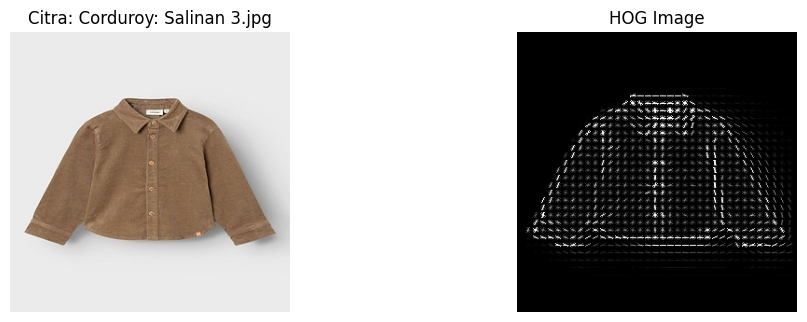


Fitur GLCM untuk Corduroy: Salinan 8.jpg:
Kontras: 124.63, Dissimilarity: 3.54, Homogeneity: 0.56, Energy: 0.41, Correlation: 0.99
Hu Moments untuk Corduroy: Salinan 8.jpg:
[ 1.56461227e-03  1.99345719e-08  1.85434713e-12  2.21675002e-11
 -1.35321347e-22 -1.24063922e-15 -4.34472120e-23]


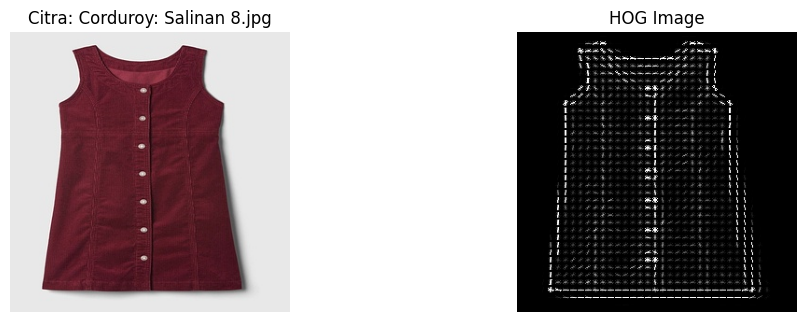


Fitur GLCM untuk Denim: Salinan 8.jpg:
Kontras: 348.01, Dissimilarity: 6.76, Homogeneity: 0.61, Energy: 0.55, Correlation: 0.98
Hu Moments untuk Denim: Salinan 8.jpg:
[1.02783583e-03 3.25102039e-09 4.04250194e-12 5.88249550e-12
 2.80446076e-24 1.54190735e-16 2.85484191e-23]


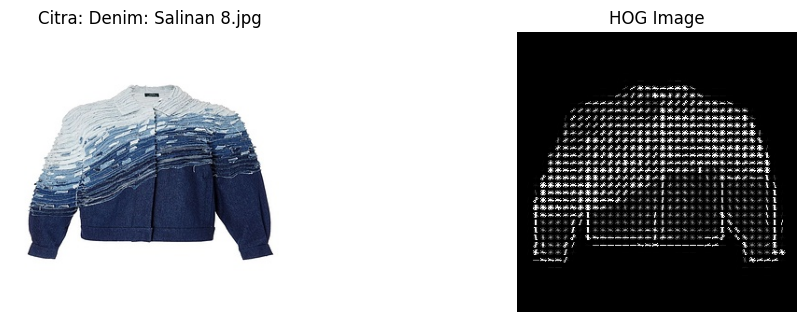


Fitur GLCM untuk Denim: Salinan 3.jpg:
Kontras: 229.67, Dissimilarity: 6.18, Homogeneity: 0.46, Energy: 0.25, Correlation: 0.98
Hu Moments untuk Denim: Salinan 3.jpg:
[ 1.96354882e-03  6.14299210e-11  2.66503220e-11  9.03965820e-11
  4.42898398e-21 -4.21603096e-16  2.64852011e-22]


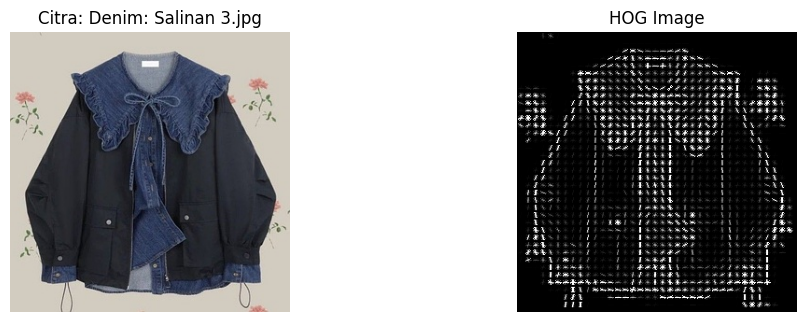


Fitur GLCM untuk Katun: Salinan 4.jpg:
Kontras: 54.13, Dissimilarity: 2.22, Homogeneity: 0.67, Energy: 0.13, Correlation: 0.97
Hu Moments untuk Katun: Salinan 4.jpg:
[ 8.47595186e-04  2.07542524e-10  1.64985040e-13  8.26212280e-14
 -9.09712853e-27 -4.91452933e-19 -3.20825848e-27]


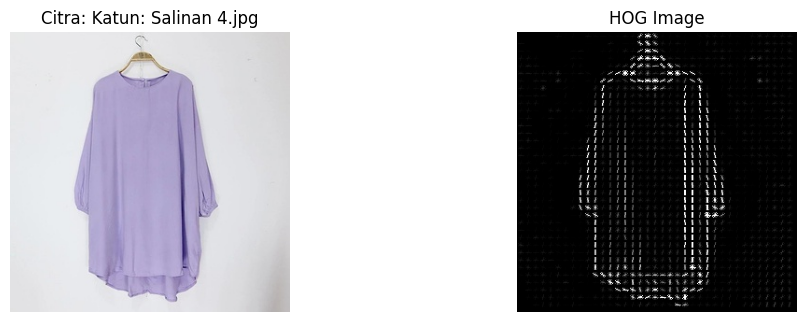


Fitur GLCM untuk Katun: Salinan 5.jpg:
Kontras: 96.37, Dissimilarity: 2.78, Homogeneity: 0.65, Energy: 0.14, Correlation: 0.99
Hu Moments untuk Katun: Salinan 5.jpg:
[ 1.07456715e-03  2.31213599e-09  2.54908849e-13  8.08353090e-13
 -3.19229578e-25 -2.97579385e-17 -1.80933284e-25]


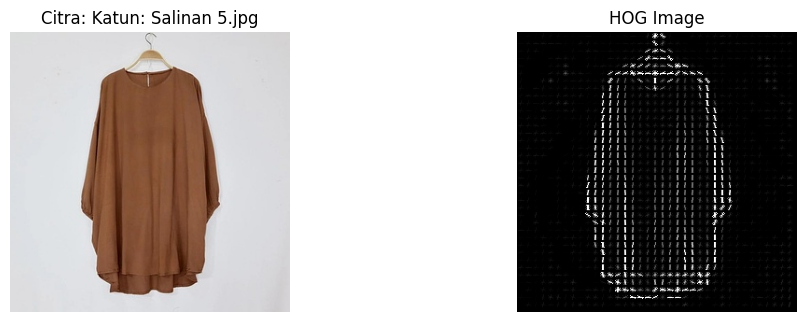


Fitur GLCM untuk Linen: Salinan 4.jpg:
Kontras: 63.82, Dissimilarity: 2.11, Homogeneity: 0.68, Energy: 0.24, Correlation: 0.91
Hu Moments untuk Linen: Salinan 4.jpg:
[ 7.50753711e-04  1.72074704e-12  1.75427478e-14  3.69067463e-14
 -4.08016133e-28 -1.07422610e-20 -8.45821384e-28]


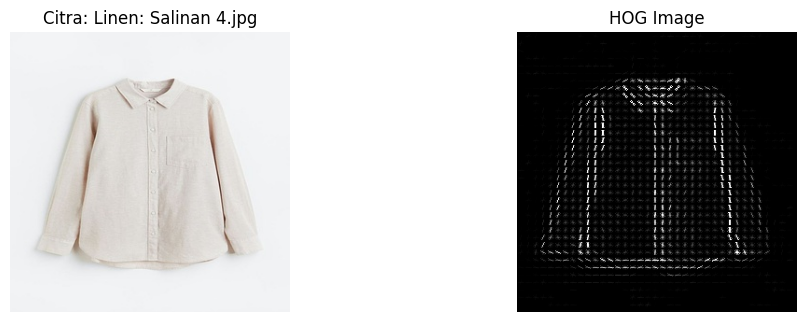


Fitur GLCM untuk Linen: Salinan 2.jpg:
Kontras: 54.25, Dissimilarity: 2.74, Homogeneity: 0.62, Energy: 0.48, Correlation: 0.97
Hu Moments untuk Linen: Salinan 2.jpg:
[9.32729417e-04 5.14961194e-11 1.38626847e-13 2.42093218e-13
 4.21034948e-26 1.58190982e-18 1.39375148e-26]


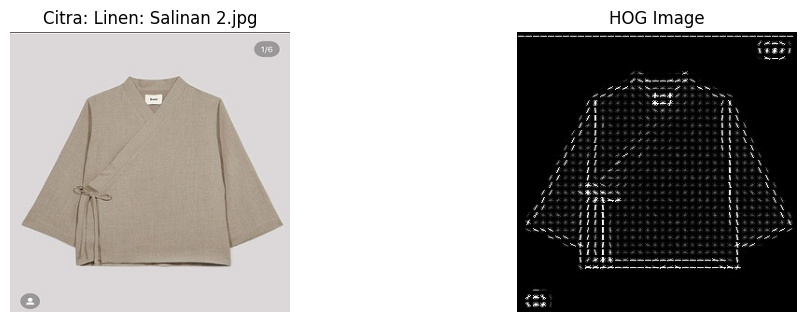


Fitur GLCM untuk Organza: Salinan 3.jpg:
Kontras: 101.72, Dissimilarity: 2.17, Homogeneity: 0.76, Energy: 0.64, Correlation: 0.98
Hu Moments untuk Organza: Salinan 3.jpg:
[ 7.64040534e-04  2.06601355e-11  1.09485000e-15  1.62289691e-14
 -6.82267400e-29  7.37614984e-20  4.99133090e-30]


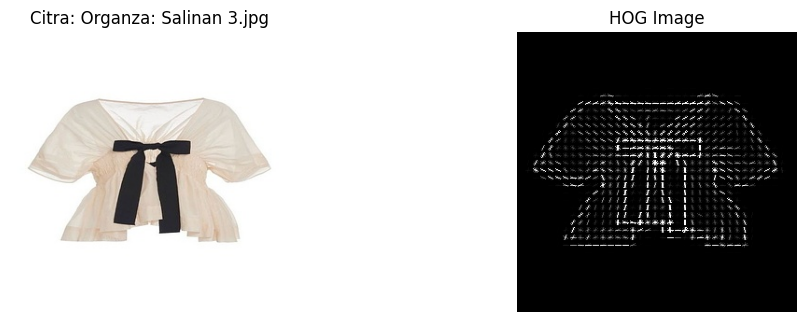


Fitur GLCM untuk Organza: Salinan 6.jpg:
Kontras: 484.43, Dissimilarity: 6.59, Homogeneity: 0.60, Energy: 0.50, Correlation: 0.98
Hu Moments untuk Organza: Salinan 6.jpg:
[ 1.28120783e-03  5.21636071e-11  4.62324658e-13  1.06373964e-12
 -3.14713361e-25 -6.36438032e-18  6.76343127e-25]


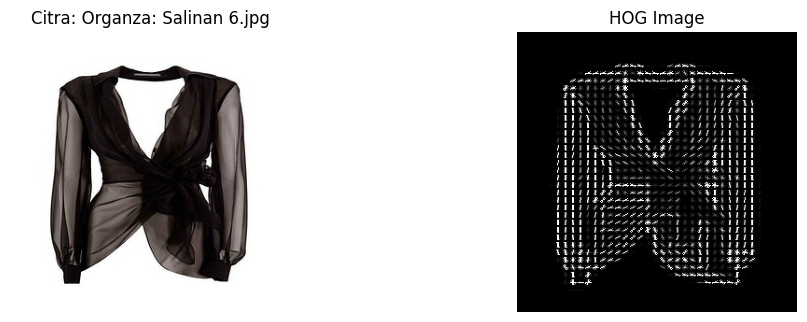


Fitur GLCM untuk Satin: Salinan 8.jpg:
Kontras: 133.98, Dissimilarity: 5.05, Homogeneity: 0.45, Energy: 0.26, Correlation: 0.97
Hu Moments untuk Satin: Salinan 8.jpg:
[ 9.10961264e-04  6.84553562e-11  3.68165075e-12  2.21490662e-12
 -5.77799011e-24  1.69142276e-17  2.57280602e-24]


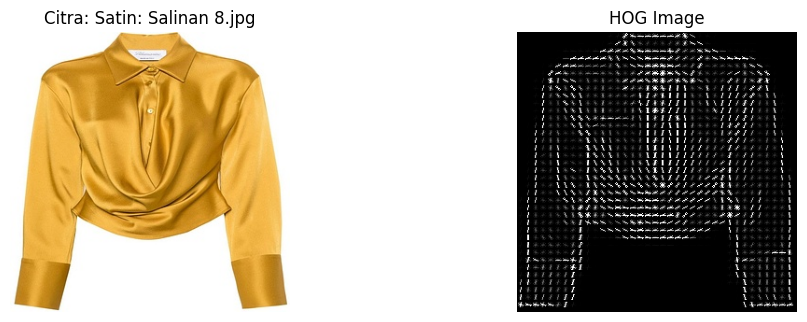


Fitur GLCM untuk Satin: Salinan 2.jpg:
Kontras: 216.18, Dissimilarity: 5.90, Homogeneity: 0.42, Energy: 0.22, Correlation: 0.97
Hu Moments untuk Satin: Salinan 2.jpg:
[ 1.03228683e-03  5.65974389e-10  7.17698269e-12  1.13660416e-13
 -9.23358725e-26  1.47771962e-18  4.48593791e-26]


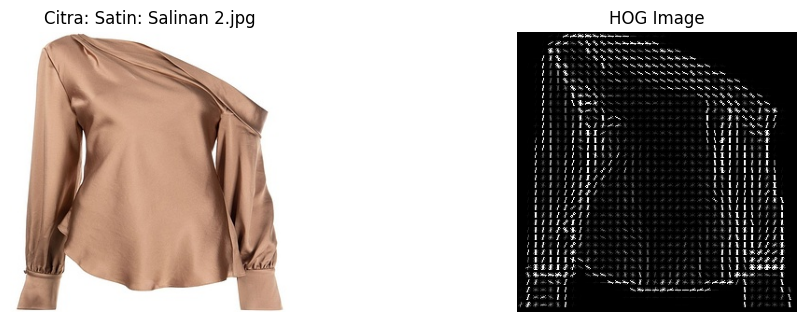

In [ ]:
folder_path = '/content/drive/MyDrive/Dataset/Jenis Kain/Hasil Resize'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

# Fitur GLCM
def calculate_glcm_features(image_gray):
    glcm = graycomatrix(image_gray, distances=[1], angles=[0], levels=256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    dissimilarity = graycoprops(glcm, 'dissimilarity')[0, 0]
    homogeneity = graycoprops(glcm, 'homogeneity')[0, 0]
    energy = graycoprops(glcm, 'energy')[0, 0]
    correlation = graycoprops(glcm, 'correlation')[0, 0]
    return [contrast, dissimilarity, homogeneity, energy, correlation]

# Hu Moments
def calculate_hu_moments(image_gray):
    moments = cv2.moments(image_gray)
    hu_moments = cv2.HuMoments(moments).flatten()
    return hu_moments

# HOG
def calculate_hog_features(image_gray):
    hog_features, hog_image = hog(image_gray, orientations=9, pixels_per_cell=(8, 8),
                                   cells_per_block=(2, 2), visualize=True)
    return hog_features, hog_image

def plot_image_and_features(image_rgb, glcm, hu_moments, hog_image, title):
    plt.figure(figsize=(12, 8))

    # Plot citra asli
    plt.subplot(2, 2, 1)
    plt.imshow(image_rgb)
    plt.title(f'Citra: {title}')
    plt.axis('off')

    # Plot citra hasil HOG
    plt.subplot(2, 2, 2)
    plt.imshow(hog_image, cmap='gray')
    plt.title('HOG Image')
    plt.axis('off')

    # Menampilkan hasil GLCM dan Hu Moments
    print(f"\nFitur GLCM untuk {title}:")
    print(f"Kontras: {glcm[0]:.2f}, Dissimilarity: {glcm[1]:.2f}, Homogeneity: {glcm[2]:.2f}, Energy: {glcm[3]:.2f}, Correlation: {glcm[4]:.2f}")

    print(f"Hu Moments untuk {title}:")
    print(f"{hu_moments}")

    plt.show()

# Sample
num_images_to_display = 2
for class_name in classes:
    class_dir = os.path.join(folder_path, class_name)

    image_files = os.listdir(class_dir)[:num_images_to_display]
    for img_name in image_files:
        img_path = os.path.join(class_dir, img_name)

        image = cv2.imread(img_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image_gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

        glcm_features = calculate_glcm_features(image_gray)
        hu_moments = calculate_hu_moments(image_gray)

        hog_features, hog_image = calculate_hog_features(image_gray)
        hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

        plot_image_and_features(image_rgb, glcm_features, hu_moments, hog_image_rescaled, f"{class_name}: {img_name}")

## **Sobel Edge Detection**

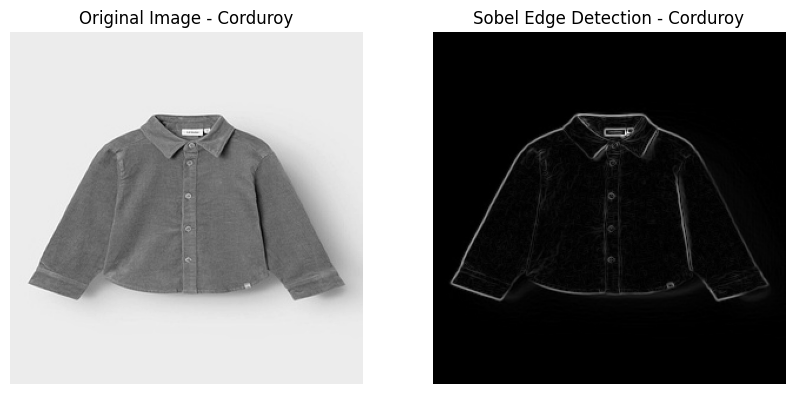

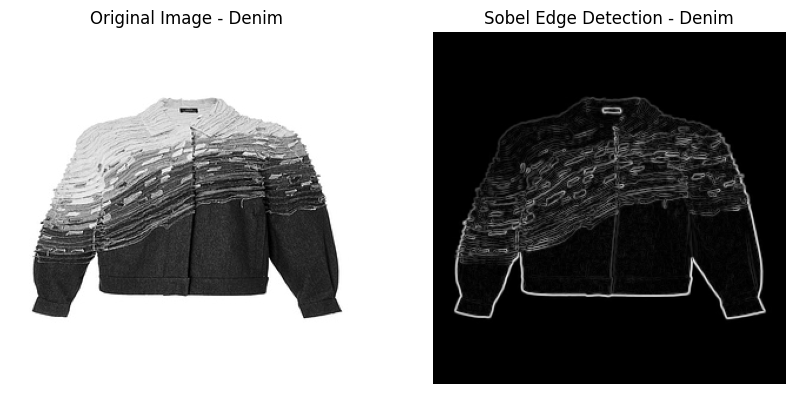

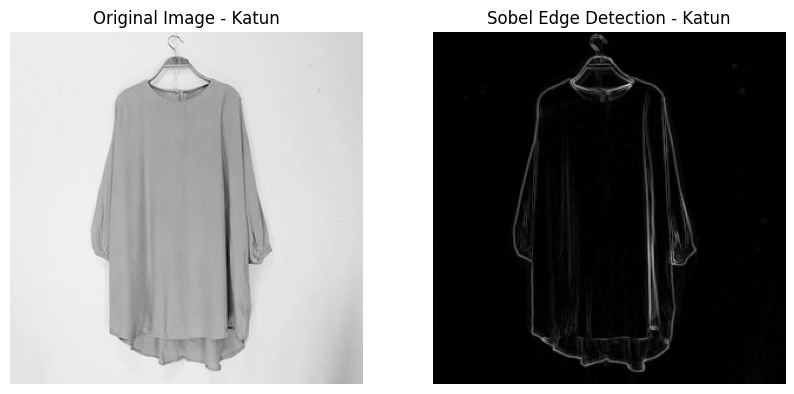

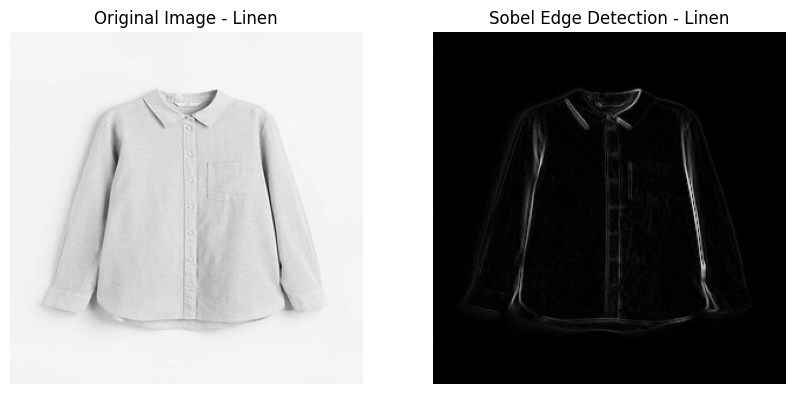

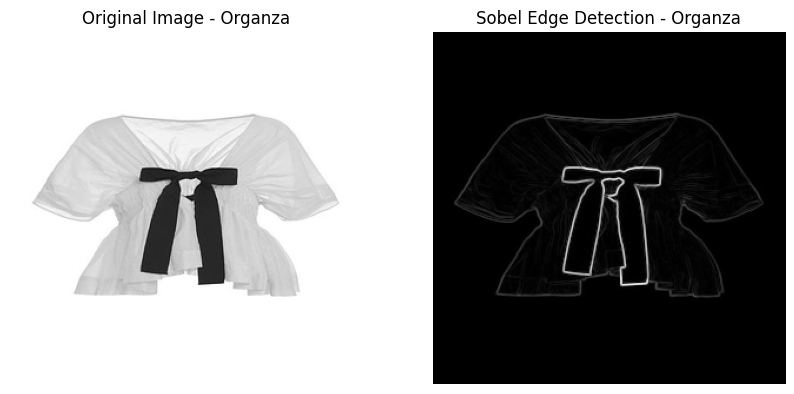

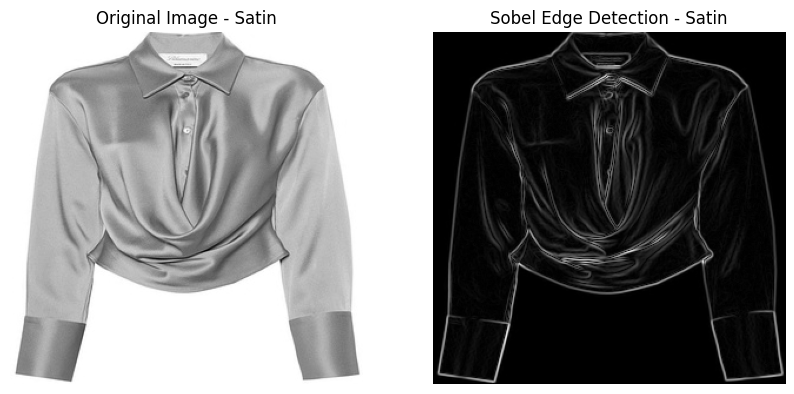

In [ ]:
folder_path = '/content/drive/MyDrive/Dataset/Jenis Kain/Hasil Resize'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

def extract_sobel_features(image_path):
    image = io.imread(image_path)
    gray_image = rgb2gray(image)

    # Sobel edge detection di arah X dan Y
    sobel_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=3)

    # magnitudo gradien
    sobel_magnitude = np.sqrt(sobel_x**2 + sobel_y**2)

    # Normalisasi hasil agar berada dalam rentang 0-255
    sobel_magnitude = (sobel_magnitude / sobel_magnitude.max()) * 255
    sobel_magnitude = sobel_magnitude.astype(np.uint8)

    return gray_image, sobel_magnitude

# Proses setiap kelas dan citra di dalamnya
for class_name in classes:
    class_folder = os.path.join(folder_path, class_name)
    image_files = os.listdir(class_folder)[:1]

    for image_file in image_files:
        image_path = os.path.join(class_folder, image_file)
        gray_image, sobel_features = extract_sobel_features(image_path)

        # Tampilkan hasil sebelum dan sesudah Sobel
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(gray_image, cmap='gray')
        axes[0].set_title(f"Original Image - {class_name}")
        axes[0].axis('off')

        axes[1].imshow(sobel_features, cmap='gray')
        axes[1].set_title(f"Sobel Edge Detection - {class_name}")
        axes[1].axis('off')

        plt.show()

## **Local Binary Pattern (Tekstur)**


Fitur GLCM untuk Corduroy: Salinan 3.jpg: [59.07315496098105, 2.5042809364548497, 0.6665401559814592, 0.4717057541888176, 0.9907394347386077]
Hu Moments untuk Corduroy: Salinan 3.jpg: [9.74967697e-04 9.50783184e-10 8.45195865e-13 5.49481206e-13
 1.58955460e-25 9.53911058e-18 3.39050256e-25]



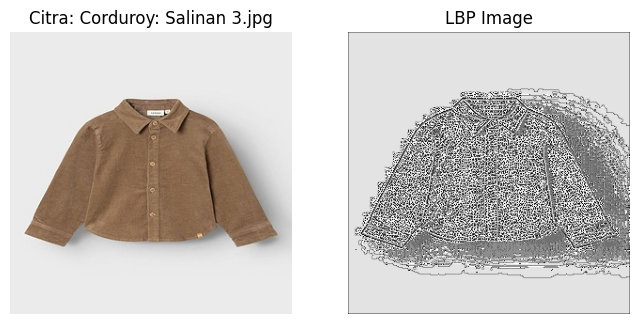


Fitur GLCM untuk Corduroy: Salinan 8.jpg: [124.6272463768116, 3.5382385730211827, 0.5579300973212762, 0.40851560448943647, 0.992370881110611]
Hu Moments untuk Corduroy: Salinan 8.jpg: [ 1.56461227e-03  1.99345719e-08  1.85434713e-12  2.21675002e-11
 -1.35321347e-22 -1.24063922e-15 -4.34472120e-23]



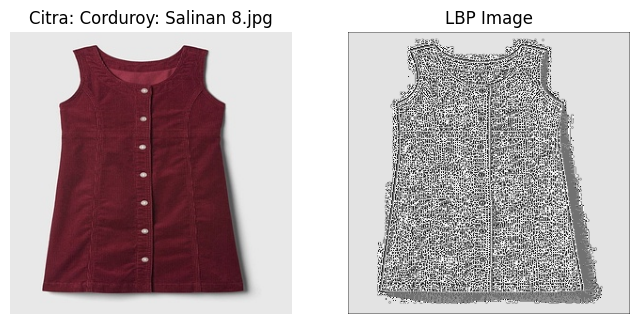


Fitur GLCM untuk Denim: Salinan 8.jpg: [348.01402452619845, 6.7612931995540695, 0.6109251623446651, 0.5494385778924817, 0.9784622427929652]
Hu Moments untuk Denim: Salinan 8.jpg: [1.02783583e-03 3.25102039e-09 4.04250194e-12 5.88249550e-12
 2.80446076e-24 1.54190735e-16 2.85484191e-23]



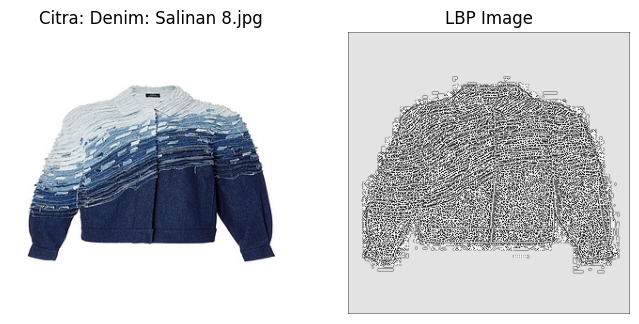


Fitur GLCM untuk Denim: Salinan 3.jpg: [229.66890746934223, 6.177224080267559, 0.45680507131825443, 0.25467120564432005, 0.980183582982465]
Hu Moments untuk Denim: Salinan 3.jpg: [ 1.96354882e-03  6.14299210e-11  2.66503220e-11  9.03965820e-11
  4.42898398e-21 -4.21603096e-16  2.64852011e-22]



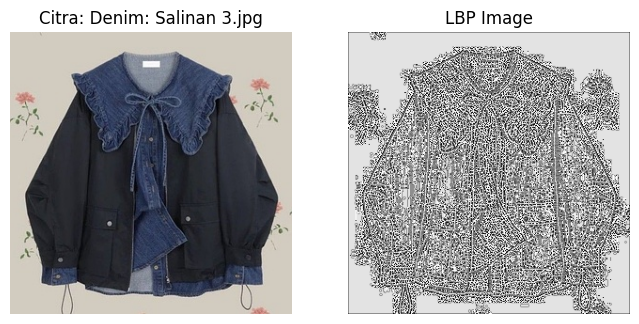


Fitur GLCM untuk Katun: Salinan 4.jpg: [54.13073578595318, 2.223890746934225, 0.6720471545893245, 0.13234562345007012, 0.9700426298864977]
Hu Moments untuk Katun: Salinan 4.jpg: [ 8.47595186e-04  2.07542524e-10  1.64985040e-13  8.26212280e-14
 -9.09712853e-27 -4.91452933e-19 -3.20825848e-27]



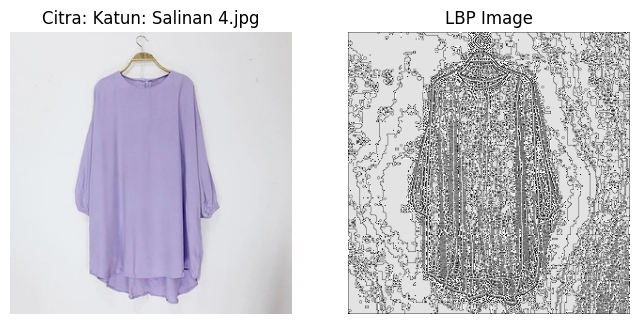


Fitur GLCM untuk Katun: Salinan 5.jpg: [96.3680044593088, 2.784503901895206, 0.6470360713390861, 0.14108861932707759, 0.9877316877606148]
Hu Moments untuk Katun: Salinan 5.jpg: [ 1.07456715e-03  2.31213599e-09  2.54908849e-13  8.08353090e-13
 -3.19229578e-25 -2.97579385e-17 -1.80933284e-25]



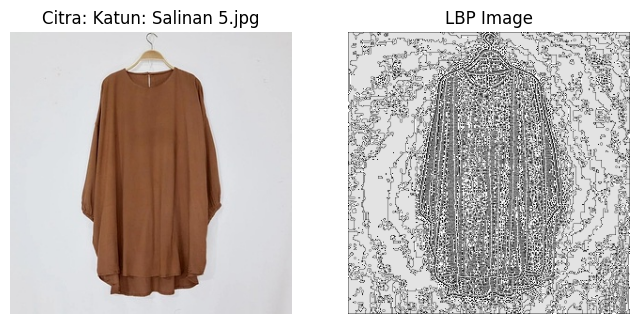


Fitur GLCM untuk Linen: Salinan 4.jpg: [63.821638795986615, 2.113210702341137, 0.6759852260410841, 0.24368310166164237, 0.9120670631405183]
Hu Moments untuk Linen: Salinan 4.jpg: [ 7.50753711e-04  1.72074704e-12  1.75427478e-14  3.69067463e-14
 -4.08016133e-28 -1.07422610e-20 -8.45821384e-28]



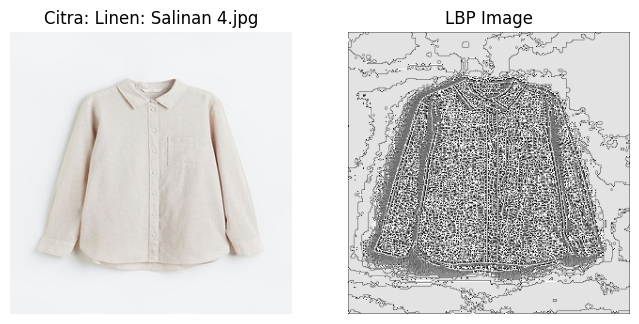


Fitur GLCM untuk Linen: Salinan 2.jpg: [54.250791527313275, 2.739933110367893, 0.6169749952727052, 0.4838039075744986, 0.972002530586107]
Hu Moments untuk Linen: Salinan 2.jpg: [9.32729417e-04 5.14961194e-11 1.38626847e-13 2.42093218e-13
 4.21034948e-26 1.58190982e-18 1.39375148e-26]



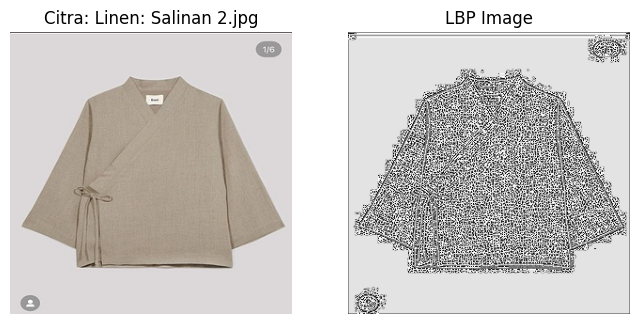


Fitur GLCM untuk Organza: Salinan 3.jpg: [101.72078037904126, 2.1688963210702346, 0.755817875283955, 0.6357196882207024, 0.9775847224380328]
Hu Moments untuk Organza: Salinan 3.jpg: [ 7.64040534e-04  2.06601355e-11  1.09485000e-15  1.62289691e-14
 -6.82267400e-29  7.37614984e-20  4.99133090e-30]



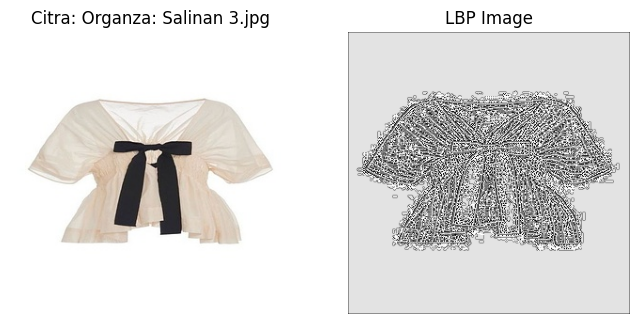


Fitur GLCM untuk Organza: Salinan 6.jpg: [484.43353400222964, 6.594960981047937, 0.6043755275460743, 0.5016983868449856, 0.9788434561847068]
Hu Moments untuk Organza: Salinan 6.jpg: [ 1.28120783e-03  5.21636071e-11  4.62324658e-13  1.06373964e-12
 -3.14713361e-25 -6.36438032e-18  6.76343127e-25]



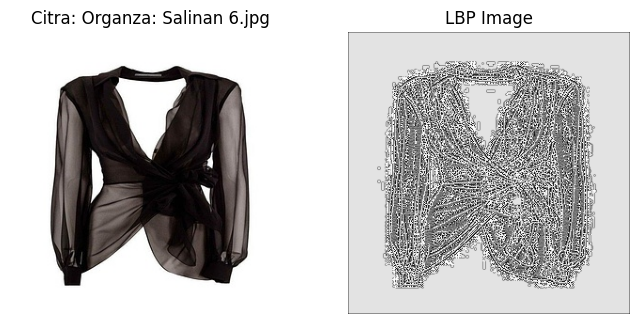


Fitur GLCM untuk Satin: Salinan 8.jpg: [133.9785061315496, 5.054136008918617, 0.44619055874233104, 0.2593487282718858, 0.9719246507541326]
Hu Moments untuk Satin: Salinan 8.jpg: [ 9.10961264e-04  6.84553562e-11  3.68165075e-12  2.21490662e-12
 -5.77799011e-24  1.69142276e-17  2.57280602e-24]



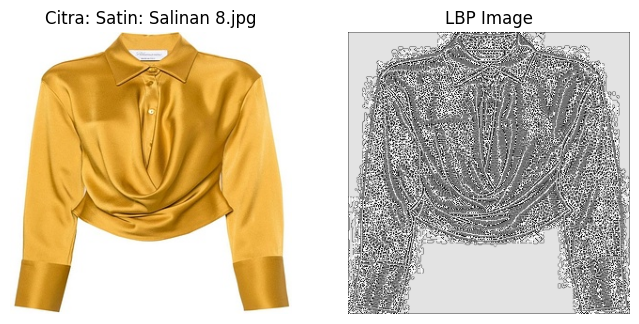


Fitur GLCM untuk Satin: Salinan 2.jpg: [216.1810479375697, 5.8997993311036785, 0.4219265402929495, 0.217781558070161, 0.96813705792386]
Hu Moments untuk Satin: Salinan 2.jpg: [ 1.03228683e-03  5.65974389e-10  7.17698269e-12  1.13660416e-13
 -9.23358725e-26  1.47771962e-18  4.48593791e-26]



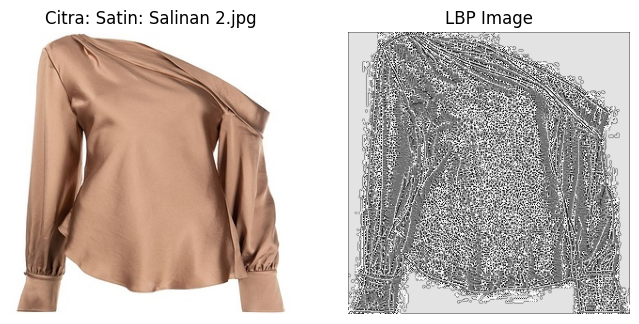

In [ ]:
data_dir = '/content/drive/MyDrive/Dataset/Jenis Kain/Kain Model'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

# Ekstraksi fitur GLCM
def calculate_glcm_features(image_gray):
    glcm = graycomatrix(image_gray, [1], [0], levels=256, symmetric=True, normed=True)
    return [graycoprops(glcm, prop)[0, 0] for prop in ('contrast', 'dissimilarity', 'homogeneity', 'energy', 'correlation')]

# Ekstraksi fitur Hu Moments
def calculate_hu_moments(image_gray):
    return cv2.HuMoments(cv2.moments(image_gray)).flatten()

# Ekstraksi fitur LBP
def calculate_lbp(image_gray, P=8, R=1):
    lbp = local_binary_pattern(image_gray, P, R, method='uniform')
    return lbp, np.histogram(lbp.ravel(), bins=np.arange(0, P + 3), range=(0, P + 2))[0]

# Plot citra dan fitur
def plot_image_and_features(image_rgb, glcm, hu_moments, lbp_image, title):
    plt.figure(figsize=(8, 6))
    plt.subplot(1, 2, 1); plt.imshow(image_rgb); plt.axis('off'); plt.title(f'Citra: {title}')
    plt.subplot(1, 2, 2); plt.imshow(lbp_image, cmap='gray'); plt.axis('off'); plt.title('LBP Image')
    print(f"\nFitur GLCM untuk {title}: {glcm}")
    print(f"Hu Moments untuk {title}: {hu_moments}\n")
    plt.show()

# Proses setiap gambar
for class_name in classes:
    class_dir = os.path.join(data_dir, class_name)
    for img_name in os.listdir(class_dir)[:2]:  # Tampilkan 2 gambar per kelas
        img_path = os.path.join(class_dir, img_name)
        image = cv2.imread(img_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image_gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

        # Ekstraksi fitur
        glcm = calculate_glcm_features(image_gray)
        hu_moments = calculate_hu_moments(image_gray)
        lbp_image, _ = calculate_lbp(image_gray)

        # Tampilkan hasil
        plot_image_and_features(image_rgb, glcm, hu_moments, lbp_image, f"{class_name}: {img_name}")


# **Splitting**

In [ ]:
data_dir = '/content/drive/MyDrive/Dataset/Jenis Kain/Hasil Resize'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

# Dataset training
train_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset="training",
    seed=46,
    image_size=(h, w),
    batch_size=batch
)

# Dataset validasi
val_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset="validation",
    seed=46,
    image_size=(h, w),
    batch_size=batch
)

Found 600 files belonging to 6 classes.
Using 480 files for training.
Found 600 files belonging to 6 classes.
Using 120 files for validation.


# **Pre-Model**

## **SVM - Histogram Warna**

In [ ]:
def compute_histogram(image):
    histogram = cv2.calcHist([image], [0, 1, 2], None, [32, 32, 32], [0, 256, 0, 256, 0, 256])
    histogram = cv2.normalize(histogram, histogram).flatten()
    return histogram

features = []
labels = []

# Ekstrak fitur untuk setiap gambar dalam dataset
for class_name in classes:
    class_folder = os.path.join(data_dir, class_name)
    for image_file in os.listdir(class_folder):
        image_path = os.path.join(class_folder, image_file)
        image = cv2.imread(image_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        histogram = compute_histogram(image_rgb)
        features.append(histogram)
        labels.append(class_name)

features = np.array(features)
labels = np.array(labels)

In [ ]:
# Membagi data menjadi data latih dan data uji
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

In [ ]:
# Membangun dan melatih model SVM
model = SVC(kernel='linear')
model.fit(X_train, y_train)

SVC(kernel='linear')

In [ ]:
# Evaluasi model
y_pred = model.predict(X_test)

In [ ]:
# Classification Report
print("\nClassification Report:\n", classification_report(y_test, y_pred))


Classification Report:
               precision    recall  f1-score   support

    Corduroy       0.00      0.00      0.00        23
       Denim       0.29      0.10      0.15        20
       Katun       0.70      0.84      0.76        19
       Linen       0.20      0.18      0.19        17
     Organza       0.20      0.82      0.32        17
       Satin       1.00      0.08      0.15        24

    accuracy                           0.31       120
   macro avg       0.40      0.34      0.26       120
weighted avg       0.41      0.31      0.25       120



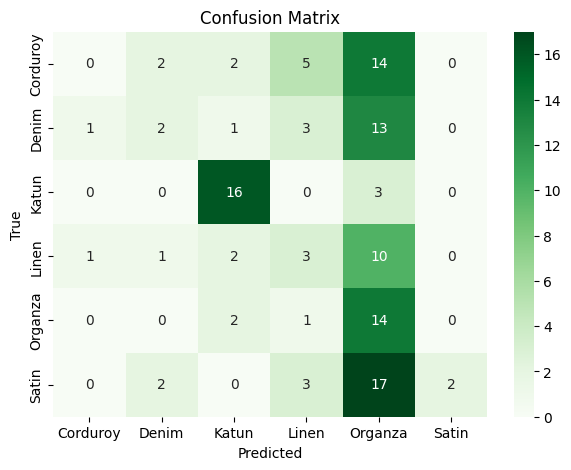

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(7, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Greens', xticklabels=classes, yticklabels=classes)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

## **SVM - Moment Warna**

In [ ]:
def calculate_color_moments(image):
    channels = cv2.split(image)
    color_moments = []

    for channel in channels:
        mean = np.mean(channel)
        variance = np.var(channel)
        skewness = skew(channel.flatten())
        color_moments.extend([mean, variance, skewness])

    return color_moments

features = []
labels = []

# Ekstrak fitur untuk setiap gambar dalam dataset
for class_name in classes:
    class_folder = os.path.join(data_dir, class_name)
    for image_file in os.listdir(class_folder):
        image_path = os.path.join(class_folder, image_file)
        image = cv2.imread(image_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        color_moments = calculate_color_moments(image_rgb)
        features.append(color_moments)
        labels.append(class_name)

features = np.array(features)
labels = np.array(labels)

In [ ]:
# Pembagian dataset menjadi data latih dan data uji
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

In [ ]:
# Membangun dan melatih model SVM
model = SVC(kernel='linear')
model.fit(X_train, y_train)

SVC(kernel='linear')

In [ ]:
# Evaluasi model
y_pred = model.predict(X_test)

In [ ]:
# Tampilkan classification report
print("\nClassification Report:\n", classification_report(y_test, y_pred))


Classification Report:
               precision    recall  f1-score   support

    Corduroy       0.56      0.65      0.60        23
       Denim       0.59      0.95      0.73        20
       Katun       0.42      0.26      0.32        19
       Linen       0.56      0.53      0.55        17
     Organza       0.30      0.41      0.35        17
       Satin       0.30      0.12      0.18        24

    accuracy                           0.48       120
   macro avg       0.46      0.49      0.45       120
weighted avg       0.45      0.48      0.45       120



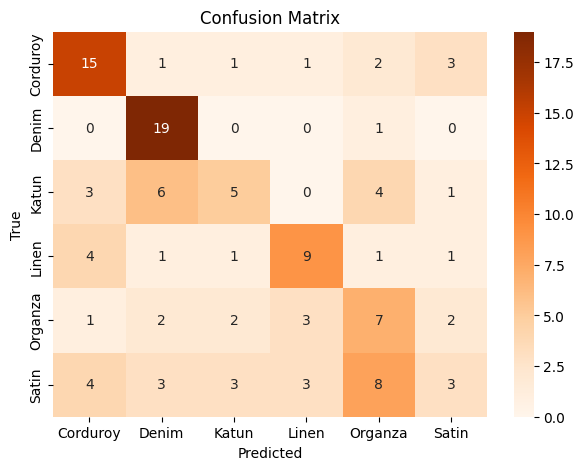

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(7, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Oranges', xticklabels=classes, yticklabels=classes)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

## **SVM - HOG (Tekstur)**

In [ ]:
folder_path = '/content/drive/MyDrive/Dataset/Jenis Kain/Hasil Resize'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

# Fitur GLCM
def calculate_glcm_features(image_gray):
    glcm = graycomatrix(image_gray, distances=[1], angles=[0], levels=256, symmetric=True, normed=True)
    return [graycoprops(glcm, prop)[0, 0] for prop in ['contrast', 'dissimilarity', 'homogeneity', 'energy', 'correlation']]

# HOG
def calculate_hog_features(image_gray):
    return hog(image_gray, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2))

X, y = [], []

for class_index, class_name in enumerate(classes):
    class_dir = os.path.join(folder_path, class_name)
    for img_name in os.listdir(class_dir):
        image_gray = cv2.cvtColor(cv2.imread(os.path.join(class_dir, img_name)), cv2.COLOR_BGR2GRAY)
        X.append(calculate_hog_features(image_gray))
        y.append(class_index)

X, y = np.array(X), np.array(y)

In [ ]:
# Splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Pelatihan dan Prediksi Model SVM
model = svm.SVC(kernel='linear', C=1.0).fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
# Evaluasi model
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.50      0.39      0.44        23
           1       0.42      0.55      0.48        20
           2       0.90      1.00      0.95        19
           3       0.57      0.71      0.63        17
           4       0.53      0.53      0.53        17
           5       0.88      0.62      0.73        24

    accuracy                           0.62       120
   macro avg       0.64      0.63      0.63       120
weighted avg       0.64      0.62      0.63       120



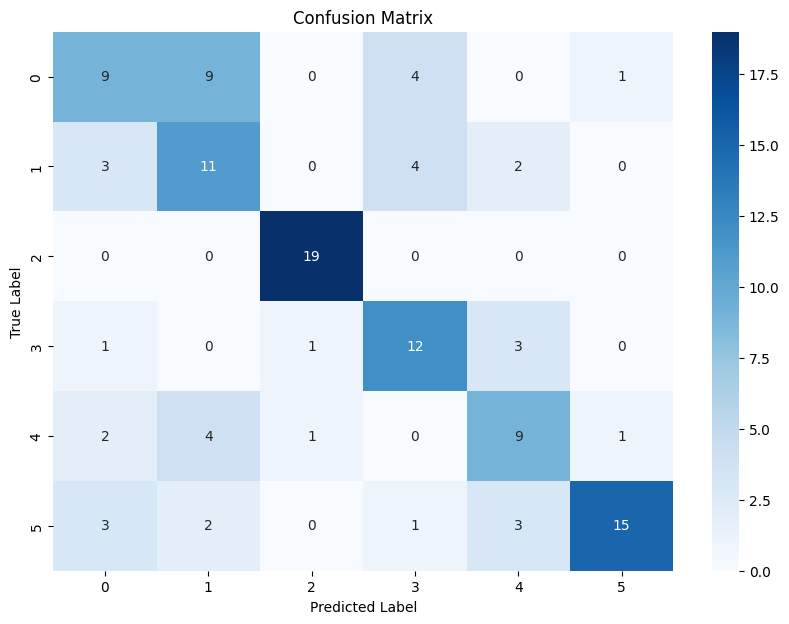

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y_test), yticklabels=np.unique(y_test))
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

### **Miss Classifier**

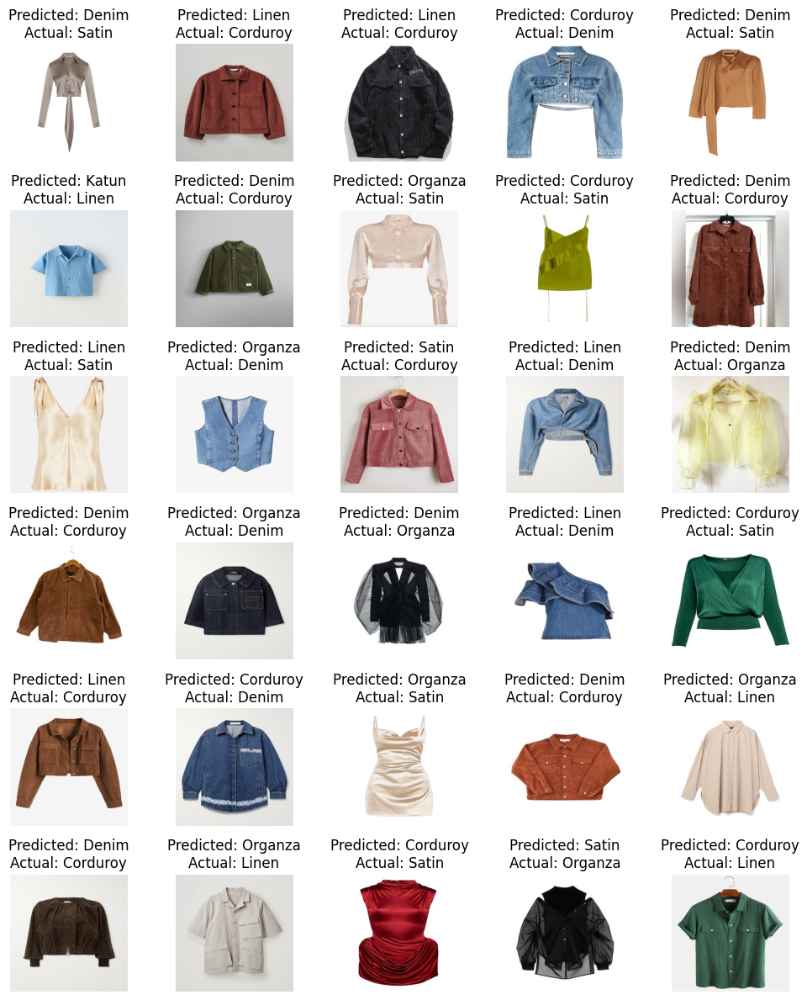

In [ ]:
# Miss Classifier
misclassified_indices = np.where(y_pred != y_test)[0]
plt.figure(figsize=(10, 12))
for i, index in enumerate(misclassified_indices[:30]):
    img_path = os.path.join(folder_path, classes[y_test[index]], os.listdir(os.path.join(folder_path, classes[y_test[index]]))[index])
    image_rgb = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

    plt.subplot(6, 5, i + 1)
    plt.imshow(image_rgb)
    plt.title(f"Predicted: {classes[y_pred[index]]}\nActual: {classes[y_test[index]]}")
    plt.axis('off')

plt.tight_layout()
plt.show()

## **SVM - Sobel Edge Detection**

In [ ]:
folder_path = '/content/drive/MyDrive/Dataset/Jenis Kain/Hasil Resize'
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

def extract_sobel_features(image_path):
    gray_image = rgb2gray(io.imread(image_path))
    sobel_magnitude = np.sqrt(cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=3)**2 +
                              cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=3)**2)
    return (sobel_magnitude / sobel_magnitude.max() * 255).astype(np.uint8).flatten()

features, labels = [], []

for class_name in classes:
    for image_file in os.listdir(os.path.join(folder_path, class_name)):
        image_path = os.path.join(folder_path, class_name, image_file)
        features.append(extract_sobel_features(image_path))
        labels.append(class_name)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(np.array(features), np.array(labels), test_size=0.2, random_state=42)

In [ ]:
model = SVC(kernel='linear').fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
print("\nClassification Report:\n", classification_report(y_test, y_pred))


Classification Report:
               precision    recall  f1-score   support

    Corduroy       0.48      0.43      0.45        23
       Denim       0.48      0.50      0.49        20
       Katun       0.95      1.00      0.97        19
       Linen       0.37      0.76      0.50        17
     Organza       0.36      0.24      0.29        17
       Satin       0.83      0.42      0.56        24

    accuracy                           0.55       120
   macro avg       0.58      0.56      0.54       120
weighted avg       0.59      0.55      0.55       120



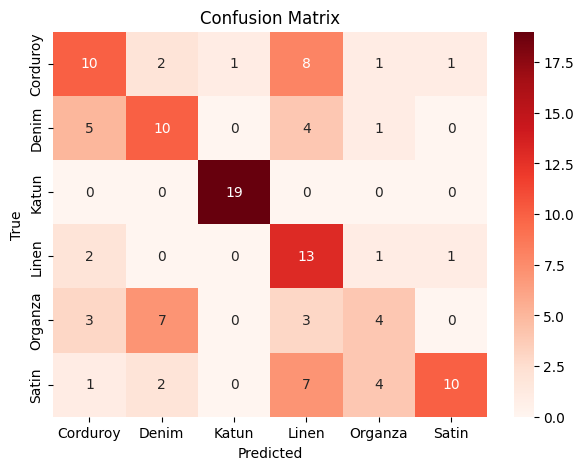

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(7, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Reds', xticklabels=classes, yticklabels=classes)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

### **Miss Classifier**

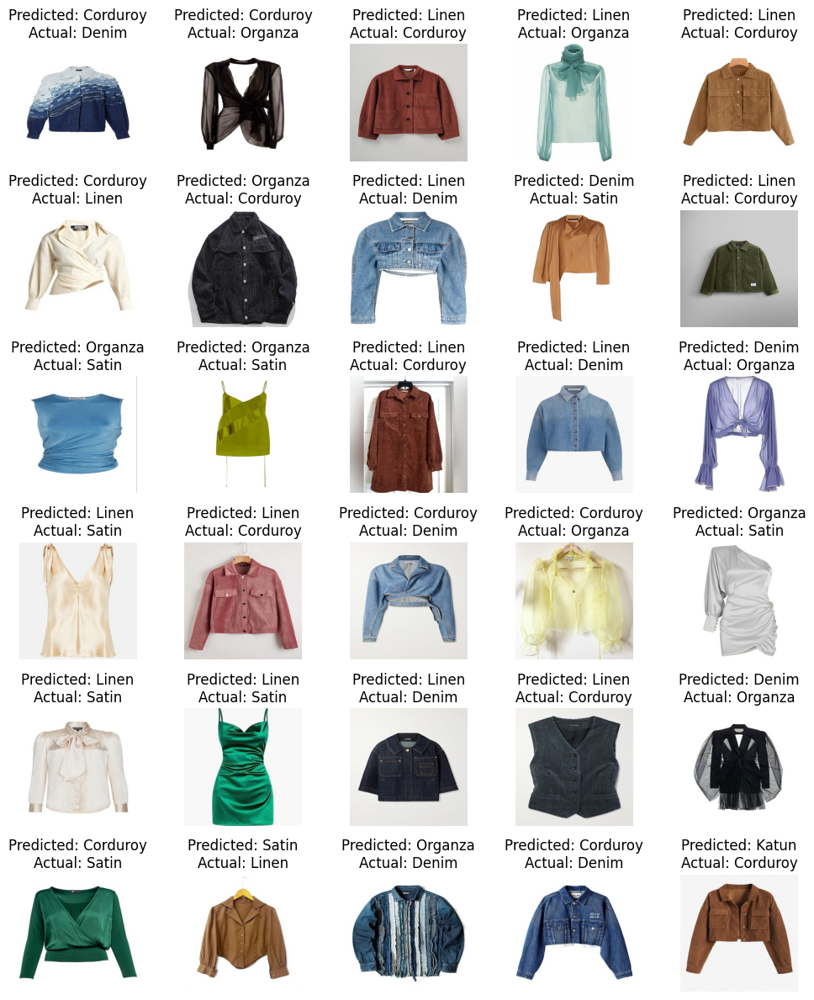

In [ ]:
# Visualisasi misclassified images
misclassified_indices = np.where(y_pred != y_test)[0]
plt.figure(figsize=(10, 12))
for i, index in enumerate(misclassified_indices[:30]):
    img_path = os.path.join(folder_path, y_test[index], os.listdir(os.path.join(folder_path, y_test[index]))[index])
    image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

    plt.subplot(6, 5, i + 1)
    plt.imshow(image)
    plt.title(f"Predicted: {y_pred[index]}\nActual: {y_test[index]}")
    plt.axis('off')

plt.tight_layout()
plt.show()

## **SVM - LBP**

In [ ]:
def calculate_lbp(image_gray, P=8, R=1):
    lbp = local_binary_pattern(image_gray, P, R, method='uniform')
    lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, P + 3), range=(0, P + 2))
    return lbp_hist.astype("float") / (lbp_hist.sum() + 1e-6)

features = []
labels = []

# Ekstrak fitur untuk semua gambar
for class_name in classes:
    class_dir = os.path.join(data_dir, class_name)
    for img_name in os.listdir(class_dir):
        img_path = os.path.join(class_dir, img_name)
        image = cv2.imread(img_path)
        image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        lbp_hist = calculate_lbp(image_gray)
        features.append(lbp_hist)
        labels.append(class_name)

features = np.array(features)
labels = np.array(labels)

In [ ]:
# Pembagian dataset menjadi data latih dan data uji
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

In [ ]:
# Membangun dan melatih model SVM
model = SVC(kernel='linear')
model.fit(X_train, y_train)

SVC(kernel='linear')

In [ ]:
# Evaluasi model
y_pred = model.predict(X_test)

In [ ]:
report = classification_report(y_test, y_pred)
print("Classification Report:\n", report)

Classification Report:
               precision    recall  f1-score   support

    Corduroy       0.40      0.09      0.14        23
       Denim       0.00      0.00      0.00        20
       Katun       0.39      0.84      0.53        19
       Linen       0.00      0.00      0.00        17
     Organza       0.18      0.71      0.29        17
       Satin       0.00      0.00      0.00        24

    accuracy                           0.25       120
   macro avg       0.16      0.27      0.16       120
weighted avg       0.16      0.25      0.15       120



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


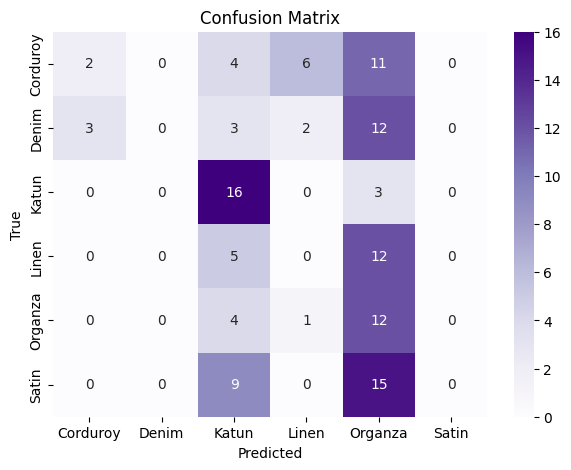

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(7, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Purples', xticklabels=classes, yticklabels=classes)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# MODEL CNN

## Splitting Dataset

In [ ]:
import os
import shutil
from sklearn.model_selection import train_test_split

# Definisikan jalur direktori asli dan direktori tujuan
base_dir = '/content/drive/MyDrive/Dataset/Jenis Kain/Jenis Kain/'

train_dir = os.path.join(base_dir, 'Train')
val_dir = os.path.join(base_dir, 'Validation')
test_dir = os.path.join(base_dir, 'Test')

# Buat direktori tujuan jika belum ada
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

categories = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']

for category in categories:
    # Buat direktori kategori di dalam train, validation, dan test
    os.makedirs(os.path.join(train_dir, category), exist_ok=True)
    os.makedirs(os.path.join(val_dir, category), exist_ok=True)
    os.makedirs(os.path.join(test_dir, category), exist_ok=True)

    # Dapatkan semua file gambar dalam kategori ini
    category_dir = os.path.join(base_dir, category)
    files = os.listdir(category_dir)
    files = [f for f in files if f.endswith('.jpg') or f.endswith('.png') or f.endswith('.bmp')]

    # Bagi data menjadi train (70%) dan temp (30%)
    train_files, temp_files = train_test_split(files, test_size=0.3, random_state=42)

    # Bagi temp menjadi validation (15%) dan test (15%)
    val_files, test_files = train_test_split(temp_files, test_size=0.5, random_state=42)

    # Salin file ke direktori masing-masing
    for file in train_files:
        shutil.copy(os.path.join(category_dir, file), os.path.join(train_dir, category, file))

    for file in val_files:
        shutil.copy(os.path.join(category_dir, file), os.path.join(val_dir, category, file))

    for file in test_files:
        shutil.copy(os.path.join(category_dir, file), os.path.join(test_dir, category, file))

print("Data telah berhasil dibagi menjadi Train (70%), Validation (15%), dan Test (15%).")

Data telah berhasil dibagi menjadi Train (70%), Validation (15%), dan Test (15%).


## Preprocessing dan Augmentasi

In [ ]:
#Parameter konfigurasi
h, w = 300, 300
batch = 32
epochs = 20
num_classes = 6
classes = ['Corduroy', 'Denim', 'Katun', 'Linen', 'Organza', 'Satin']
base_dir = '/content/drive/MyDrive/Dataset/Jenis Kain/Jenis Kain/'
train_dir = f'{base_dir}/Train'
val_dir = f'{base_dir}/Validation'
test_dir = f'{base_dir}/Test'
features = []
labels = []

In [ ]:
# Load dataset
train_ds = tf.keras.utils.image_dataset_from_directory(
    train_dir,
    seed=123,
    image_size=(h, w),
    batch_size=batch
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    val_dir,
    seed=123,
    image_size=(h, w),
    batch_size=batch
)

test_ds = tf.keras.utils.image_dataset_from_directory(
    test_dir,
    seed=123,
    image_size=(h, w),
    batch_size=batch
)

Found 420 files belonging to 6 classes.
Found 90 files belonging to 6 classes.
Found 90 files belonging to 6 classes.


In [ ]:
# Data augmentation
data_augmentation = Sequential([
    RandomFlip("horizontal_and_vertical"),  # Flip secara horizontal dan vertikal
    RandomRotation(0.2),  # Rotasi hingga 20%
    RandomZoom(0.2),      # Zoom hingga 20%
    RandomBrightness(0.2) # Perubahan kecerahan hingga 20%
])

## Model

In [ ]:
model = Sequential([
    data_augmentation,
    Rescaling(1./255, input_shape=(h, w, 3)), # Input layer
    Conv2D(32, (3, 3), activation='relu'),    # Convolutional layer
    MaxPooling2D(2, 2),   # Max pooling layer
    Conv2D(64, (3, 3), activation='relu'),    # Convolutional layer
    MaxPooling2D(2, 2),   # Max pooling layer
    Conv2D(128, (3, 3), activation='relu'),   # Convolutional layer
    MaxPooling2D(2, 2),   # Max pooling layer
    Flatten(), #flatten layer
    Dense(128, activation='relu'), #fully connected layer
    Dropout(0.5), #Mengatasi overfitting
    Dense(num_classes, activation='softmax')  # output
])
#compile
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ sequential_12 (Sequential)           │ (None, 300, 300, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ rescaling_7 (Rescaling)              │ (None, 300, 300, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_21 (Conv2D)                   │ (None, 298, 298, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_21 (MaxPooling2D)      │ (None, 149, 149, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_22 (Conv2D)                   │ (None, 147, 147, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_22 (MaxPooling2D)      │ (None, 73, 73, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_23 (Conv2D)                   │ (None, 71, 71, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_23 (MaxPooling2D)      │ (None, 35, 35, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_7 (Flatten)                  │ (None, 156800)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (None, 512)                 │      80,282,112 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_15 (Dense)                     │ (None, 6)                   │           3,078 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 80,378,438 (306.62 MB)

 Trainable params: 80,378,438 (306.62 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
#Training
history = model.fit(train_ds, validation_data=val_ds, epochs=epochs, batch_size=batch)

Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 15s 865ms/step - accuracy: 0.2191 - loss: 8.3045 - val_accuracy: 0.4222 - val_loss: 1.6097
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 12s 834ms/step - accuracy: 0.2968 - loss: 1.6665 - val_accuracy: 0.3111 - val_loss: 2.0380
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 20s 835ms/step - accuracy: 0.3430 - loss: 1.6910 - val_accuracy: 0.4556 - val_loss: 1.4700
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 12s 801ms/step - accuracy: 0.4218 - loss: 1.4703 - val_accuracy: 0.3444 - val_loss: 1.4851
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 21s 855ms/step - accuracy: 0.4201 - loss: 1.5124 - val_accuracy: 0.5444 - val_loss: 1.3522
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 13s 872ms/step - accuracy: 0.4722 - loss: 1.3737 - val_accuracy: 0.4889 - val_loss: 1.4302
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 20s 755ms/step - accuracy: 0.4341 - loss: 1.4657 - val_accuracy: 0.5778 - val_loss: 1.3059
Epoch 8/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 12s 818ms/step - accuracy: 0.4657 - loss: 1.4270 - val_accu

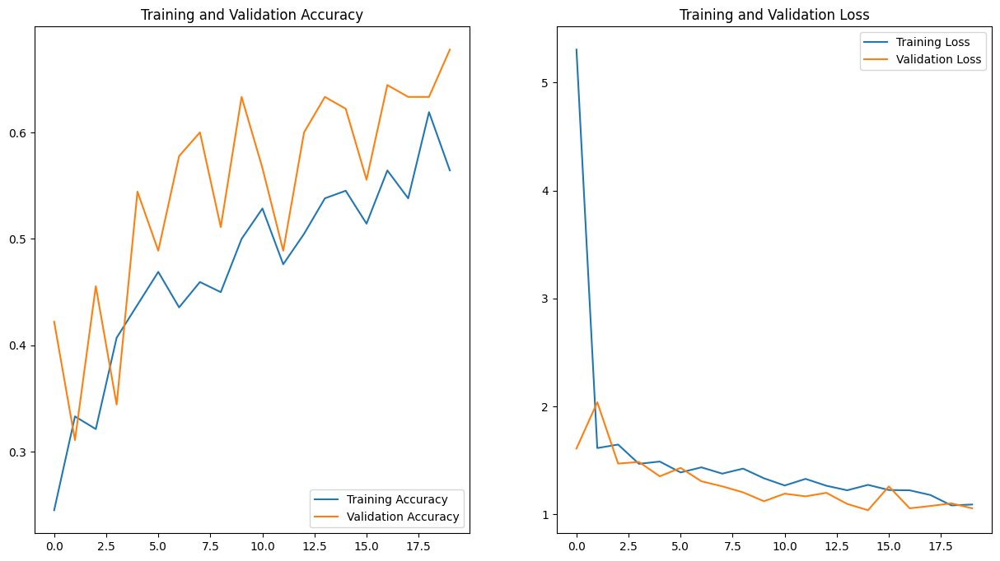

In [ ]:
#Evaluasi
#Menampilkan Learning Curve

# Akurasi
plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.plot(range(epochs), history.history['accuracy'], label='Training Accuracy')
plt.plot(range(epochs), history.history['val_accuracy'], label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

# Loss
plt.subplot(1, 2, 2)
plt.plot(range(epochs), history.history['loss'], label='Training Loss')
plt.plot(range(epochs), history.history['val_loss'], label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [ ]:
loss, accuracy = model.evaluate(val_ds)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - accuracy: 0.6553 - loss: 1.0594
Test accuracy : 0.6777777671813965
Test loss : 1.0558446645736694


In [ ]:
y_true = []
y_pred = []
for images, labels in val_ds:
    batch_predictions = model.predict(images)
    batch_pred_labels = np.argmax(batch_predictions, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(batch_pred_labels)

y_true = np.array(y_true)
y_pred = np.array(y_pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


In [ ]:
print(classification_report(y_true, y_pred, target_names=classes))

              precision    recall  f1-score   support

    Corduroy       0.67      0.80      0.73        15
       Denim       0.81      0.87      0.84        15
       Katun       0.76      0.87      0.81        15
       Linen       0.58      0.47      0.52        15
     Organza       0.73      0.53      0.62        15
       Satin       0.50      0.53      0.52        15

    accuracy                           0.68        90
   macro avg       0.68      0.68      0.67        90
weighted avg       0.68      0.68      0.67        90



## **Pre-trained**

### **ResNet101**

In [ ]:
base_model = ResNet101(
    weights='imagenet',
    input_tensor=Input(shape=(300, 300, 3)),
    include_top=False
)

In [ ]:
base_model.trainable = False

In [ ]:
x = base_model.output
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(3, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [ ]:
history = model.fit(
    train_ds,
    epochs=20,
    validation_data=val_ds,
)

Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - accuracy: 0.1423 - loss: nan - val_accuracy: 0.1667 - val_loss: nan
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 6s 387ms/step - accuracy: 0.1777 - loss: nan - val_accuracy: 0.1667 - val_loss: nan
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 10s 333ms/step - accuracy: 0.1775 - loss: nan - val_accuracy: 0.1667 - val_loss: nan
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 6s 385ms/step - accuracy: 0.1881 - loss: nan - val_accuracy: 0.1667 - val_loss: nan
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 10s 362ms/step - accuracy: 0.1631 - loss: nan - val_accuracy: 0.1667 - val_loss: nan
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 10s 328ms/step - accuracy: 0.1890 - loss: nan - val_accuracy: 0.1667 - val_loss: nan
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 6s 379ms/step - accuracy: 0.2042 - loss: nan - val_accuracy: 0.1667 - val_loss: nan
Epoch 8/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 10s 371ms/step - accuracy: 0.1858 - loss: nan - val_accuracy: 0.1667 - val_loss: nan
Epoch 9/20
14/14 ━━━━━

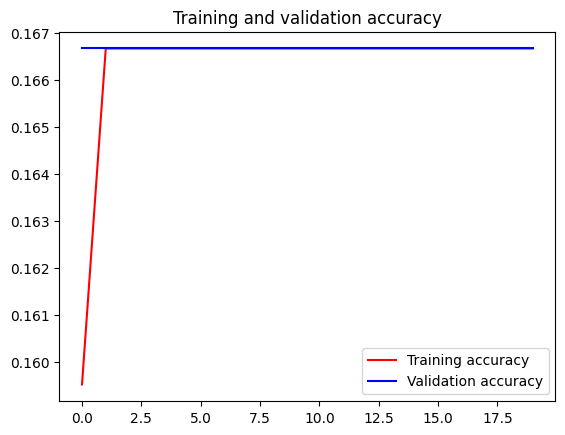

<Figure size 640x480 with 0 Axes>

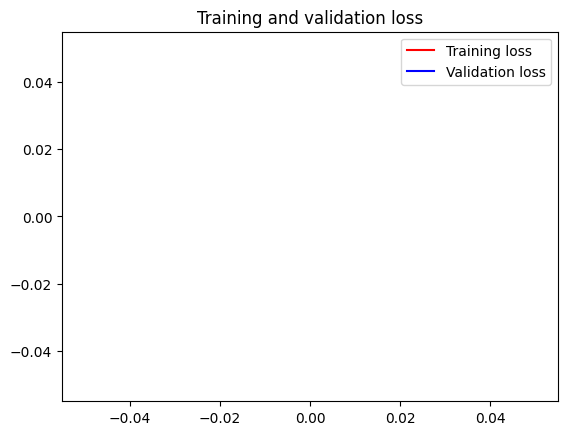

<Figure size 640x480 with 0 Axes>

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend(loc=0)
plt.figure()

plt.show()

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend(loc=0)
plt.figure()

plt.show()

In [ ]:
# Evaluasi model
loss, accuracy = model.evaluate(test_ds)
print(f"Test Loss: {loss:.4f}")
print(f"Test Accuracy: {accuracy:.4f}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 22s 7s/step - accuracy: 0.1732 - loss: nan
Test Loss: nan
Test Accuracy: 0.1667


In [ ]:
y_true = []
y_pred = []
for images, labels in val_ds:
    batch_predictions = model.predict(images)
    batch_pred_labels = np.argmax(batch_predictions, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(batch_pred_labels)

y_true = np.array(y_true)
y_pred = np.array(y_pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step


In [ ]:
print(classification_report(y_true, y_pred, target_names=classes))

              precision    recall  f1-score   support

    Corduroy       0.17      1.00      0.29        15
       Denim       0.00      0.00      0.00        15
       Katun       0.00      0.00      0.00        15
       Linen       0.00      0.00      0.00        15
     Organza       0.00      0.00      0.00        15
       Satin       0.00      0.00      0.00        15

    accuracy                           0.17        90
   macro avg       0.03      0.17      0.05        90
weighted avg       0.03      0.17      0.05        90



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


### **VGG16**

In [ ]:
# Load VGG16 Pretrained Model
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(300, 300, 3))

# Freeze the convolutional base
base_model.trainable = False

# Create the Model
model = Sequential([
    base_model,  # VGG16 pretrained base
    Flatten(),  # Flatten the output
    Dense(256, activation='relu'),  # Fully connected layer
    Dropout(0.5),  # Regularization to prevent overfitting
    Dense(6, activation='softmax')  # Output layer (6 classes: adjust to your dataset)
])

# Kompilasi model
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


In [ ]:
history = model.fit(
    train_ds,
    epochs=20,
    validation_data=val_ds
)

Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 225s 14s/step - accuracy: 0.4709 - loss: 42.1913 - val_accuracy: 0.7333 - val_loss: 10.1058
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 4s 310ms/step - accuracy: 0.7430 - loss: 9.1382 - val_accuracy: 0.8111 - val_loss: 5.5347
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 284ms/step - accuracy: 0.8552 - loss: 2.4268 - val_accuracy: 0.8556 - val_loss: 2.0153
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 324ms/step - accuracy: 0.8739 - loss: 2.4988 - val_accuracy: 0.8111 - val_loss: 4.2117
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 316ms/step - accuracy: 0.8975 - loss: 2.0209 - val_accuracy: 0.9000 - val_loss: 2.0627
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 324ms/step - accuracy: 0.9329 - loss: 0.7356 - val_accuracy: 0.8778 - val_loss: 1.8175
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 328ms/step - accuracy: 0.9378 - loss: 1.3083 - val_accuracy: 0.8778 - val_loss: 2.1914
Epoch 8/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 306ms/step - accuracy: 0.9737 - loss: 0.6396 - val_accuracy: 

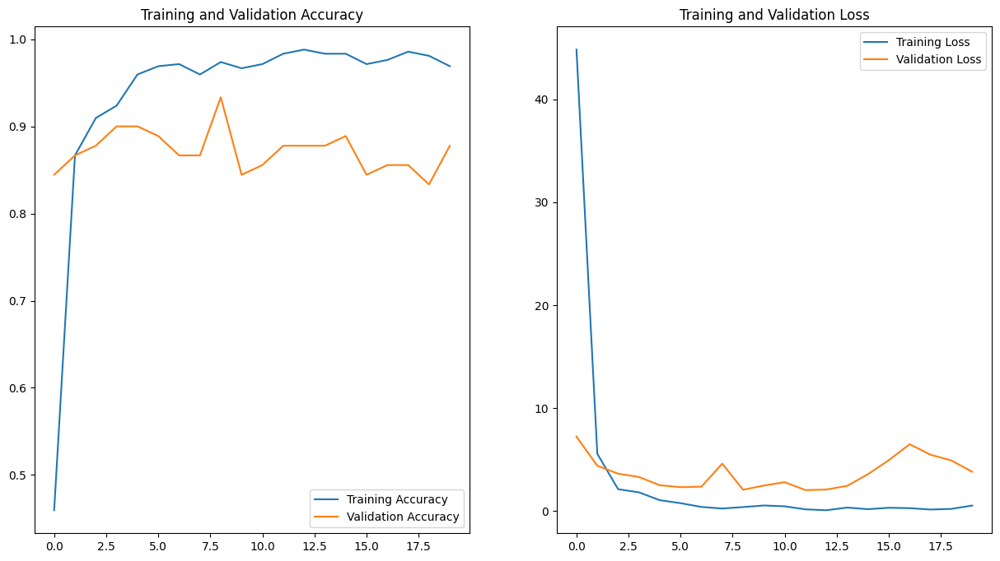

In [ ]:
#Evaluasi
#Menampilkan Learning Curve

# Akurasi
plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.plot(range(epochs), history.history['accuracy'], label='Training Accuracy')
plt.plot(range(epochs), history.history['val_accuracy'], label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

# Loss
plt.subplot(1, 2, 2)
plt.plot(range(epochs), history.history['loss'], label='Training Loss')
plt.plot(range(epochs), history.history['val_loss'], label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [ ]:
loss, accuracy = model.evaluate(val_ds)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 225ms/step - accuracy: 0.8686 - loss: 4.1765
Test accuracy : 0.8777777552604675
Test loss : 3.8288207054138184


In [ ]:
y_true = []
y_pred = []
for images, labels in val_ds:
    batch_predictions = model.predict(images)
    batch_pred_labels = np.argmax(batch_predictions, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(batch_pred_labels)

y_true = np.array(y_true)
y_pred = np.array(y_pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


In [ ]:
print(classification_report(y_true, y_pred, target_names=classes))

              precision    recall  f1-score   support

    Corduroy       0.75      0.80      0.77        15
       Denim       0.88      0.93      0.90        15
       Katun       1.00      1.00      1.00        15
       Linen       0.85      0.73      0.79        15
     Organza       0.87      0.87      0.87        15
       Satin       0.93      0.93      0.93        15

    accuracy                           0.88        90
   macro avg       0.88      0.88      0.88        90
weighted avg       0.88      0.88      0.88        90

